In [12]:
from scipy.signal import find_peaks, savgol_filter
from sklearn.metrics import adjusted_rand_score
from sklearn.cluster import KMeans, DBSCAN
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import neurokit2 as nk
from tqdm import tqdm
import pandas as pd
import numpy as np
import umap
import h5py

import torch.optim as optim
from sklearn.model_selection import train_test_split

import torch
import torch.nn as nn
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from torch.utils.data import DataLoader, TensorDataset, random_split

import warnings
warnings.filterwarnings("ignore")

In [2]:
device='cpu'

In [89]:
class AttentionLayer(nn.Module):
    """Механизм внимания для временных рядов."""
    def __init__(self, hidden_dim):
        super().__init__()
        self.query = nn.Linear(hidden_dim, hidden_dim)
        self.key = nn.Linear(hidden_dim, hidden_dim)

    def forward(self, x):
        # x: (batch, seq_len, hidden_dim)
        Q = self.query(x)
        K = self.key(x)
        scores = torch.matmul(Q, K.transpose(1, 2)) / torch.sqrt(torch.tensor(x.shape[-1]))
        weights = torch.softmax(scores, dim=-1)
        return torch.matmul(weights, x)

class ECGEncoder(nn.Module):
    def __init__(self, input_dim=1, hidden_dim=64):
        super().__init__()
        self.conv1 = nn.Conv1d(input_dim, 32, kernel_size=5, padding=2)
        self.conv2 = nn.Conv1d(32, 64, kernel_size=3, padding=1)
        self.pool = nn.MaxPool1d(kernel_size=2)
        self.lstm = nn.LSTM(64, hidden_dim, batch_first=True)
        self.attention = AttentionLayer(hidden_dim)

    def forward(self, x):
        # len_ = x.shape[2]
        x = x.permute(0, 2, 1)  # (batch, 1, seq_len) -> (batch, channels, seq_len)
        x = self.pool(torch.relu(self.conv1(x)))
        x = self.pool(torch.relu(self.conv2(x)))
        x = x.permute(0, 2, 1)  # (batch, seq_len, channels)
        x, _ = self.lstm(x)
        x = self.attention(x)
        return x

class ECGDecoder(nn.Module):
    def __init__(self, hidden_dim=64, output_dim=1):
        super().__init__()
        self.lstm = nn.LSTM(hidden_dim, hidden_dim, batch_first=True)
        self.upconv1 = nn.ConvTranspose1d(
            hidden_dim, 32, 
            kernel_size=3, 
            stride=2,
            output_padding=1
        )
        self.upconv2 = nn.ConvTranspose1d(
            32, output_dim, 
            kernel_size=5, 
            stride=2,
            padding=2,
            output_padding=1
        )

        self.len = 0
        
    def forward(self, x):
        x, _ = self.lstm(x)
        x = x.permute(0, 2, 1)
        x = torch.relu(self.upconv1(x))
        # x = torch.tanh(self.upconv2(x))  # <- tanh вместо sigmoid
        x = self.upconv2(x)
        return x.permute(0, 2, 1)[:, :self.len, :]
    
    def set_len(self, len_):
        self.len = len_

class ECGAutoencoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.encoder = ECGEncoder()
        self.decoder = ECGDecoder()

    def forward(self, x):
        encoded = self.encoder(x)

        self.decoder.set_len(x.shape[1])

        decoded = self.decoder(encoded)
        return decoded

    def get_embeddings(self, x):
        with torch.no_grad():
            return self.encoder(x)

In [4]:
def load_data(metadata_filepath='metadata.csv', N_start=0, N_end=10, only_health=False):
    """Загрузка данных из файлов.\n
    Работает только при наличии директории 'records',\n
    в которой пять папок по 5000 файлов записей"""
    
    # Загружаем метаданные и выбираем срезом нужные
    metadata_full = pd.read_csv(metadata_filepath)
    metadata = metadata_full.iloc[N_start:N_end]

    # Убираем лишние столбцы, приводим к типу int32
    metadata = metadata.drop(columns=['Date', 'Patient_ID'])
    metadata['Age'].astype(np.int32)
    metadata['N'].astype(np.int32)

    if only_health:
        # Берём только здоровых людей
        health_metadata = metadata.loc[metadata['AHA_Code'] == '1']
        id_metadata = health_metadata['ECG_ID'].values
        labels = health_metadata['AHA_Code'].values
    else:
        # Берём всех
        id_metadata = metadata['ECG_ID'].values
        labels = metadata['AHA_Code'].values

    signals = []

    for i in id_metadata:
        # Из Axxxxx оставляем численную часть
        number = int(i[1:])

        # В каждой папке 5000 файлов (кроме пятой), поэтому,
        # чтобы узнать номер папки, в которой запись, делим на 5000
        record_num = (number - 1) // 5000
        if record_num > 4:
            record_num = 4
        record_num = record_num + 1
        
        # Считываем файл.
        if record_num == 1:
            file_name_ = f'../records/record{record_num}/{i}.h5'
        else:
            file_name_ = f'../records/records{record_num}/{i}.h5'
        with h5py.File(file_name_, 'r') as f:
            signals.append(f['ecg'][()])
    
    health_n = len(labels[labels == '1'])
    diseased_n = len(labels[labels != '1'])

    print(f"Data loaded successfully.\n\
          Health    number:     {health_n}\n\
          Diseased  number:     {diseased_n}\n\n")

    return signals, labels

def load_data_age_sex(metadata_filepath='metadata.csv', N_start=0, N_end=10, only_health=False):
    """Загрузка данных из файлов.\n
    Работает только при наличии директории 'records',\n
    в которой пять папок по 5000 файлов записей"""
    
    # Загружаем метаданные и выбираем срезом нужные
    metadata_full = pd.read_csv(metadata_filepath)
    metadata = metadata_full.iloc[N_start:N_end]

    # Убираем лишние столбцы, приводим к типу int32
    metadata = metadata.drop(columns=['Date', 'Patient_ID'])
    metadata['Age'].astype(np.int32)
    metadata['N'].astype(np.int32)

    metadata['Sex'].replace({'M': 0, 'F': 1}, inplace=True)

    if only_health:
        # Берём только здоровых людей
        health_metadata = metadata.loc[metadata['AHA_Code'] == '1']
        id_metadata = health_metadata['ECG_ID'].values
        labels = health_metadata['AHA_Code'].values
        ages = health_metadata['Age'].values
        sexs = health_metadata['Sex'].values
    else:
        # Берём всех
        id_metadata = metadata['ECG_ID'].values
        labels = metadata['AHA_Code'].values
        ages = metadata['Age'].values
        sexs = metadata['Sex'].values

    signals = []

    for i in id_metadata:
        # Из Axxxxx оставляем численную часть
        number = int(i[1:])

        # В каждой папке 5000 файлов (кроме пятой), поэтому,
        # чтобы узнать номер папки, в которой запись, делим на 5000
        record_num = (number - 1) // 5000
        if record_num > 4:
            record_num = 4
        record_num = record_num + 1
        
        # Считываем файл.
        if record_num == 1:
            file_name_ = f'../records/record{record_num}/{i}.h5'
        else:
            file_name_ = f'../records/records{record_num}/{i}.h5'
        with h5py.File(file_name_, 'r') as f:
            signals.append(f['ecg'][()])
    
    health_n = len(labels[labels == '1'])
    diseased_n = len(labels[labels != '1'])

    print(f"Data loaded successfully.\n\
          Health    number:     {health_n}\n\
          Diseased  number:     {diseased_n}\n\n")

    return signals, labels, ages, sexs

In [5]:
def ultra_filter(signals, n=None, channel=None):
    if n == None and channel==None:
        y = signals
    else:
        y = signals[n][channel]

    # 1. Найдем пики
    peaks, _ = find_peaks(y, height=(0.1, 0.5), distance=10)
    peaks = peaks[peaks < len(y)]

    # 2. Найдем тренд с помощью фильтра Савицкого-Голея
    y_trend = savgol_filter(y, window_length=51, polyorder=3)

    # 3. Удалим тренд, чтобы получить колебания (пики и волны)
    y_fluctuations = y - y_trend

    # 4. Обработаем волны (сгладим их)
    y_waves_smoothed = savgol_filter(y_fluctuations, window_length=21, polyorder=2)

    # 5. Восстановим данные, добавив колебания к тренду
    y_restored = y_trend + y_waves_smoothed

    return y_restored

def signal_transform_tensor_1(signals, N=0, max_len_signal=5000, sampling_rate=500):
    """Транформирует сигналы в тензор.\n
    N - номер отведения в соответствии с массивом:\n
    ['I', 'II', 'III', 'aVR', 'aVL', 'aVF', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6']"""

    # Ограничиваем максимальную длину до единого значения для использования в батче.
    # Дописывать нули в конце для одной длины - сомнительная идея для LSTM.

    i = N

    result_reshape = np.reshape([ultra_filter([float(ss) for ss in signal[i][0:max_len_signal]]) for signal in signals], (1, max_len_signal * len(signals)))

    return torch.tensor(result_reshape, dtype=torch.float32).reshape((1, len(signals), max_len_signal)).permute((1,2,0))

def label_transform_tensor(labels, all_diagnoses=False):
    """Транформирует лейблы в тензор.\n
    Сейчас только в режиме 'Норма-Не норма'."""

    # TODO: сделать разбиение лейблов на первичное и вторичное заключение врача

    result_labels = []

    if all_diagnoses:
        return None
    
    else:
        # Норма - Не норма
        for label in labels:
            if label == '1':
                result_labels.append(0)
            else:
                result_labels.append(1)

    result_labels = torch.tensor(result_labels, dtype=torch.float32).reshape((len(result_labels), 1))

    print("Label transformed to tensor successfully\n")

    return result_labels

In [6]:
def ecg_quality_metrics(signal, fs=1000):
    # Очистка сигнала
    cleaned = nk.ecg_clean(signal, sampling_rate=fs)
    
    # Детекция R-пиков
    r_peaks = nk.ecg_findpeaks(cleaned, sampling_rate=fs)['ECG_R_Peaks']
    
    # Расчет SNR
    noise = signal - cleaned
    snr = 10 * np.log10(np.var(cleaned) / np.var(noise))
    
    # Стабильность RR-интервалов
    rr = np.diff(r_peaks) / fs * 1000  # в мс
    cv_rr = (np.std(rr) / np.mean(rr)) * 100  # Коэффициент вариации
    
    # return {"SNR_dB": snr, "RR_CV%": cv_rr}
    return snr, cv_rr

def ecg_quality_metrics_ultra(signal, fs=1000):
    # Очистка сигнала
    cleaned = ultra_filter(signal)
    
    # Детекция R-пиков
    r_peaks = nk.ecg_findpeaks(cleaned, sampling_rate=fs)['ECG_R_Peaks']
    
    # Расчет SNR
    noise = signal - cleaned
    snr = 10 * np.log10(np.var(cleaned) / np.var(noise))
    
    # Стабильность RR-интервалов
    rr = np.diff(r_peaks) / fs * 1000  # в мс
    cv_rr = (np.std(rr) / np.mean(rr)) * 100  # Коэффициент вариации
    
    # return {"SNR_dB": snr, "RR_CV%": cv_rr}
    return snr, cv_rr

In [57]:
def train_model(model, train_loader, test_loader, optimizer, criterion, scheduler, epochs=50, name_path="best_model"):
    best_loss = float('inf')
    for epoch in range(epochs):
        model.train()
        train_loss = 0
        for batch in tqdm(train_loader, desc=f"Epoch {epoch+1}"):
            x, _ = batch
            optimizer.zero_grad()
            output = model(x)
            loss = criterion(output, x)
            loss.backward()
            optimizer.step()
            train_loss += loss.item()
        
        # Валидация
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for batch in test_loader:
                x, _ = batch
                output = model(x)
                val_loss += criterion(output, x).item()
        
        avg_val_loss = val_loss / len(test_loader)
        scheduler.step(avg_val_loss)
        
        # Ранняя остановка
        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            torch.save(model.state_dict(), "../weights/" + name_path + ".pth")
        
        print(f"Epoch {epoch+1}: Train Loss = {train_loss/len(train_loader):.4f}, Val Loss = {avg_val_loss:.4f}")

In [8]:
def plot_reconstruction(model, test_data, sample_idx=0):
    model.eval()
    with torch.no_grad():
        sample = test_data[sample_idx].unsqueeze(0)
        reconstructed = model(sample).cpu().numpy()
    
    plt.figure(figsize=(12, 4))
    plt.plot(test_data[sample_idx].cpu().numpy(), label="Original")
    plt.plot(reconstructed[0], label="Reconstructed", alpha=0.7)
    plt.legend()
    plt.title("ECG Reconstruction")
    plt.show()

def plot_attention(model, test_data, window_size, sample_idx=0):
    model.eval()
    sample = test_data[sample_idx].unsqueeze(0)
    encoded = model.encoder(sample)
    
    # Получение весов внимания
    Q = model.encoder.attention.query(encoded)
    K = model.encoder.attention.key(encoded)
    scores = torch.matmul(Q, K.transpose(1, 2)) / torch.sqrt(torch.tensor(encoded.shape[-1]))
    weights = torch.softmax(scores, dim=-1).mean(dim=1).squeeze().detach().cpu().numpy()  # Добавлен .detach()
    
    plt.figure(figsize=(12, 4))
    plt.plot(test_data[sample_idx].cpu().numpy(), label="ECG")
    plt.imshow(weights[np.newaxis, :], cmap="hot", aspect="auto", alpha=0.5, extent=(0, window_size, -3, 3))
    plt.colorbar(label="Attention Weight")
    plt.title("Attention Map")
    plt.show()

In [50]:
def delete_bad_snr_db(signals_, labels_, channel_check=0, print_idx=False):
    signals = []
    labels = []
    deleted_idx = []
    
    for i in range(len(signals_)):
        if channel_check != -1:
            sbr_db, rr = ecg_quality_metrics_ultra(signals_[i][channel_check], 500)
        else:
            sbr_db = []
            for j in range(len(signals_[i])):
                sbr_db_, rr_ = ecg_quality_metrics_ultra(signals_[i][j], 500)
                sbr_db.append(sbr_db_)
            
            sbr_db = sum(sbr_db) / len(signals_[i])
        
        if sbr_db >= 15:
            signals.append(signals_[i])
            labels.append(labels_[i])
        else:
            deleted_idx.append(i)
    
    if print_idx:
        print("deleted indexes:")
        print(*deleted_idx)
    
    print(f"num of left: {len(signals)}")

    health_n = np.count_nonzero(np.array(labels) == '1')
    diseased_n = len(labels[labels != '1'])

    print(f"Data deleted successfully.\n\
          Health    number:     {health_n}\n\
          Diseased  number:     {diseased_n}\n\n")
    
    return signals, labels

def delete_bad_snr_db_age_sex(signals_, labels_, ages_=None, sexs_=None, channel_check=0, print_idx=False):
    signals = []
    labels = []
    ages = []
    sexs = []
    deleted_idx = []
    
    for i in range(len(signals_)):
        if channel_check != -1:
            sbr_db, rr = ecg_quality_metrics_ultra(signals_[i][channel_check], 500)
        else:
            sbr_db = []
            for j in range(len(signals_[i])):
                sbr_db_, rr_ = ecg_quality_metrics_ultra(signals_[i][j], 500)
                sbr_db.append(sbr_db_)
            
            sbr_db = sum(sbr_db) / len(signals_[i])
        
        if sbr_db >= 15:
            signals.append(signals_[i])
            labels.append(labels_[i])
            ages.append(ages_[i])
            sexs.append(sexs_[i])
        else:
            deleted_idx.append(i)
    
    if print_idx:
        print("deleted indexes:")
        print(*deleted_idx)
    
    print(f"num of left: {len(signals)}")

    health_n = np.count_nonzero(np.array(labels) == '1')
    diseased_n = len(labels) - health_n

    print(f"Data deleted successfully.\n\
          Health    number:     {health_n}\n\
          Diseased  number:     {diseased_n}\n\n")
    
    return signals, labels, ages, sexs

In [110]:
def split_into_windows(data, window_size=250, stride=125):
    windows = []
    scaler = StandardScaler()
    
    for sample in data:
        for i in range(0, len(sample) - window_size + 1, stride):
            windows.append(scaler.fit_transform(sample[i:i+window_size]))
    return np.stack(windows)

In [120]:
X = []
y = []
X_train = []
X_test = []
y_train = []
y_test = []
train_data = []
test_data = []
train_loader = []
test_loader = []

signals, labels, ages, sexs = load_data_age_sex('../csv/metadata.csv', 0, 2000, False)
signals, labels, ages, sexs = delete_bad_snr_db_age_sex(signals, labels, ages, sexs, -1)
labels_transformed = label_transform_tensor(labels)
# y_ = torch.tensor(labels_transformed, dtype=torch.float32).reshape((len(labels_transformed), 1))

window_size = 800
stride = window_size - 100

y_ = []
for i in labels_transformed:
    for k in range(7):
        y_.append(i.detach().numpy().tolist())

y_ = torch.tensor(y_, dtype=torch.float32).reshape((len(y_), 1))


for i in range(12):
    signals_transformed = signal_transform_tensor_1(signals, i)
    X_ = split_into_windows(signals_transformed, window_size=window_size, stride=stride)

    # window_size = 800
    # stride = window_size - 100
    # X = split_into_windows(signals_transformed, window_size=window_size, stride=stride)
    # X.shape

    # scaler = StandardScaler()
    # X = scaler.fit_transform(X.reshape(-1, 1)).reshape(-1, window_size, 1)

    # y = []
    # for i in labels_transformed:
    #     for k in range(7):
    #         y.append(i.detach().numpy().tolist())

    # y = torch.tensor(y, dtype=torch.float32).reshape((len(y), 1))

    # X_ = torch.tensor(signals_transformed)

    # Разделение на train/test
    X_train_, X_test_, y_train_, y_test_ = train_test_split(X_, y_, test_size=0.2, random_state=None)

    # Конвертация в тензоры
    train_data_ = torch.FloatTensor(X_train_).to(device)
    test_data_ = torch.FloatTensor(X_test_).to(device)

    train_loader_ = DataLoader(TensorDataset(train_data_, train_data_), batch_size=32, shuffle=False)
    test_loader_ = DataLoader(TensorDataset(test_data_, test_data_), batch_size=32)

    X.append(X_)
    y.append(y_)
    X_train.append(X_train_)
    X_test.append(X_test_)
    y_train.append(y_train)
    y_test.append(y_test_)
    train_data.append(train_data_)
    test_data.append(test_data_)
    train_loader.append(train_loader_)
    test_loader.append(test_loader_)

Data loaded successfully.
          Health    number:     1047
          Diseased  number:     953


num of left: 1603
Data deleted successfully.
          Health    number:     839
          Diseased  number:     764


Label transformed to tensor successfully



In [150]:
ages_ = []
for i in ages:
    for k in range(7):
        ages_.append(i)

ages_ = torch.tensor(ages_, dtype=torch.float32).reshape((len(ages_), 1))

sexs_ = []
for i in sexs:
    for k in range(7):
        sexs_.append(i)

sexs_ = torch.tensor(sexs_, dtype=torch.float32).reshape((len(sexs_), 1))

In [130]:
models = []

for i in range(12):
    model = ECGAutoencoder()
    criterion = nn.L1Loss()
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=5)
    train_model(model, train_loader[i], test_loader[i], optimizer, criterion, scheduler, epochs=5, name_path=f"best_{i}_model")
    models.append(model)

Epoch 1: 100%|██████████| 281/281 [00:23<00:00, 11.84it/s]


Epoch 1: Train Loss = 0.2211, Val Loss = 0.0648


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.03it/s]


Epoch 2: Train Loss = 0.0470, Val Loss = 0.0362


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 10.96it/s]


Epoch 3: Train Loss = 0.0343, Val Loss = 0.0511


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 11.08it/s]


Epoch 4: Train Loss = 0.0280, Val Loss = 0.0257


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 11.04it/s]


Epoch 5: Train Loss = 0.0250, Val Loss = 0.0172


Epoch 1: 100%|██████████| 281/281 [00:26<00:00, 10.76it/s]


Epoch 1: Train Loss = 0.1912, Val Loss = 0.0806


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 10.95it/s]


Epoch 2: Train Loss = 0.0442, Val Loss = 0.0420


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 10.82it/s]


Epoch 3: Train Loss = 0.0344, Val Loss = 0.0341


Epoch 4: 100%|██████████| 281/281 [00:26<00:00, 10.65it/s]


Epoch 4: Train Loss = 0.0291, Val Loss = 0.0319


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 10.90it/s]


Epoch 5: Train Loss = 0.0238, Val Loss = 0.0210


Epoch 1: 100%|██████████| 281/281 [00:25<00:00, 10.89it/s]


Epoch 1: Train Loss = 0.2544, Val Loss = 0.0928


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 10.94it/s]


Epoch 2: Train Loss = 0.0641, Val Loss = 0.0637


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 10.94it/s]


Epoch 3: Train Loss = 0.0422, Val Loss = 0.0381


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 11.02it/s]


Epoch 4: Train Loss = 0.0342, Val Loss = 0.0577


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 10.97it/s]


Epoch 5: Train Loss = 0.0328, Val Loss = 0.0210


Epoch 1: 100%|██████████| 281/281 [00:25<00:00, 10.90it/s]


Epoch 1: Train Loss = 0.1890, Val Loss = 0.0571


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 10.96it/s]


Epoch 2: Train Loss = 0.0429, Val Loss = 0.0638


Epoch 3: 100%|██████████| 281/281 [00:27<00:00, 10.38it/s]


Epoch 3: Train Loss = 0.0315, Val Loss = 0.0256


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 11.18it/s]


Epoch 4: Train Loss = 0.0265, Val Loss = 0.0293


Epoch 5: 100%|██████████| 281/281 [00:24<00:00, 11.30it/s]


Epoch 5: Train Loss = 0.0239, Val Loss = 0.0189


Epoch 1: 100%|██████████| 281/281 [00:24<00:00, 11.26it/s]


Epoch 1: Train Loss = 0.2245, Val Loss = 0.0805


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.15it/s]


Epoch 2: Train Loss = 0.0614, Val Loss = 0.0498


Epoch 3: 100%|██████████| 281/281 [00:24<00:00, 11.26it/s]


Epoch 3: Train Loss = 0.0435, Val Loss = 0.0351


Epoch 4: 100%|██████████| 281/281 [00:28<00:00,  9.84it/s]


Epoch 4: Train Loss = 0.0371, Val Loss = 0.0282


Epoch 5: 100%|██████████| 281/281 [00:27<00:00, 10.37it/s]


Epoch 5: Train Loss = 0.0307, Val Loss = 0.0233


Epoch 1: 100%|██████████| 281/281 [00:24<00:00, 11.28it/s]


Epoch 1: Train Loss = 0.2086, Val Loss = 0.0663


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.08it/s]


Epoch 2: Train Loss = 0.0535, Val Loss = 0.0435


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 11.05it/s]


Epoch 3: Train Loss = 0.0377, Val Loss = 0.0278


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 10.87it/s]


Epoch 4: Train Loss = 0.0320, Val Loss = 0.0364


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 11.05it/s]


Epoch 5: Train Loss = 0.0294, Val Loss = 0.0251


Epoch 1: 100%|██████████| 281/281 [00:25<00:00, 11.18it/s]


Epoch 1: Train Loss = 0.2343, Val Loss = 0.0886


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.20it/s]


Epoch 2: Train Loss = 0.0529, Val Loss = 0.0368


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 10.89it/s]


Epoch 3: Train Loss = 0.0382, Val Loss = 0.0349


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 10.98it/s]


Epoch 4: Train Loss = 0.0306, Val Loss = 0.0345


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 10.88it/s]


Epoch 5: Train Loss = 0.0285, Val Loss = 0.0315


Epoch 1: 100%|██████████| 281/281 [00:25<00:00, 11.14it/s]


Epoch 1: Train Loss = 0.2172, Val Loss = 0.0640


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 10.96it/s]


Epoch 2: Train Loss = 0.0428, Val Loss = 0.0259


Epoch 3: 100%|██████████| 281/281 [00:29<00:00,  9.63it/s]


Epoch 3: Train Loss = 0.0320, Val Loss = 0.0341


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 10.81it/s]


Epoch 4: Train Loss = 0.0304, Val Loss = 0.0205


Epoch 5: 100%|██████████| 281/281 [00:26<00:00, 10.70it/s]


Epoch 5: Train Loss = 0.0238, Val Loss = 0.0219


Epoch 1: 100%|██████████| 281/281 [00:27<00:00, 10.11it/s]


Epoch 1: Train Loss = 0.1899, Val Loss = 0.0486


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.05it/s]


Epoch 2: Train Loss = 0.0421, Val Loss = 0.0314


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 10.92it/s]


Epoch 3: Train Loss = 0.0340, Val Loss = 0.0271


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 11.13it/s]


Epoch 4: Train Loss = 0.0273, Val Loss = 0.0214


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 10.91it/s]


Epoch 5: Train Loss = 0.0245, Val Loss = 0.0231


Epoch 1: 100%|██████████| 281/281 [00:25<00:00, 11.08it/s]


Epoch 1: Train Loss = 0.1893, Val Loss = 0.0464


Epoch 2: 100%|██████████| 281/281 [00:26<00:00, 10.74it/s]


Epoch 2: Train Loss = 0.0393, Val Loss = 0.0340


Epoch 3: 100%|██████████| 281/281 [00:28<00:00, 10.01it/s]


Epoch 3: Train Loss = 0.0293, Val Loss = 0.0290


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 11.13it/s]


Epoch 4: Train Loss = 0.0267, Val Loss = 0.0184


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 10.89it/s]


Epoch 5: Train Loss = 0.0239, Val Loss = 0.0179


Epoch 1: 100%|██████████| 281/281 [00:25<00:00, 11.08it/s]


Epoch 1: Train Loss = 0.1844, Val Loss = 0.0481


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.11it/s]


Epoch 2: Train Loss = 0.0415, Val Loss = 0.0314


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 11.04it/s]


Epoch 3: Train Loss = 0.0323, Val Loss = 0.0256


Epoch 4: 100%|██████████| 281/281 [00:25<00:00, 11.07it/s]


Epoch 4: Train Loss = 0.0254, Val Loss = 0.0248


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 10.97it/s]


Epoch 5: Train Loss = 0.0237, Val Loss = 0.0182


Epoch 1: 100%|██████████| 281/281 [00:27<00:00, 10.04it/s]


Epoch 1: Train Loss = 0.2002, Val Loss = 0.0494


Epoch 2: 100%|██████████| 281/281 [00:25<00:00, 11.03it/s]


Epoch 2: Train Loss = 0.0460, Val Loss = 0.0301


Epoch 3: 100%|██████████| 281/281 [00:25<00:00, 11.12it/s]


Epoch 3: Train Loss = 0.0328, Val Loss = 0.0276


Epoch 4: 100%|██████████| 281/281 [00:26<00:00, 10.78it/s]


Epoch 4: Train Loss = 0.0297, Val Loss = 0.0197


Epoch 5: 100%|██████████| 281/281 [00:25<00:00, 11.04it/s]


Epoch 5: Train Loss = 0.0239, Val Loss = 0.0171


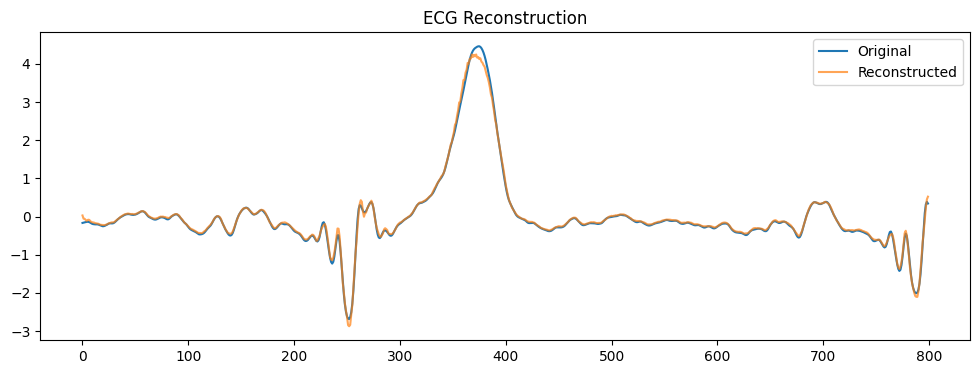

In [140]:
plot_reconstruction(models[4], test_data[4], 2)

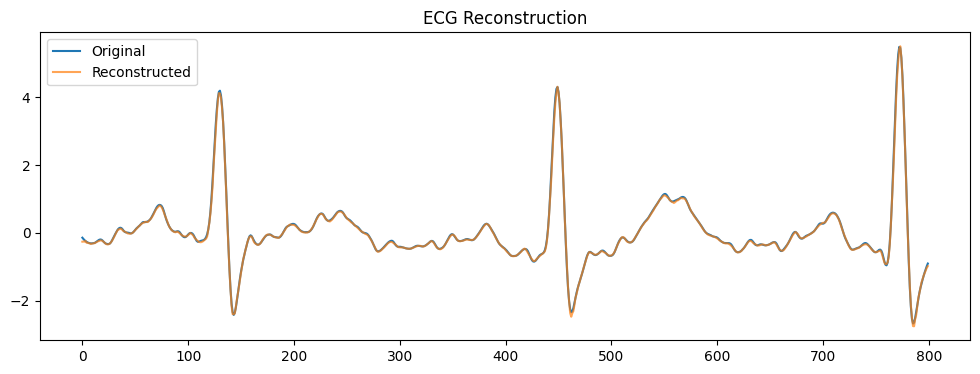

In [137]:
plot_reconstruction(models[0], test_data[0], 2)

In [141]:
def umaper(model, x_data, y_data, n_components=2, alpha=0.3):
    model.eval()

    with torch.no_grad():
        embeddings = model.get_embeddings(x_data).numpy()
    
    embeddings_avg = embeddings.mean(axis=1)
    reducer = umap.UMAP(n_components=n_components)
    embeddings_2d = reducer.fit_transform(embeddings_avg)

    num = [331, 332, 333, 334, 335, 336, 337, 338, 339]
    k = 0

    print("UMAP, average")
    for i in range(n_components):
        for j in range(i, n_components):
            if k >= 9:
                k = 0
                plt.show()
                plt.figure()
            plt.subplot(num[k])

            plt.scatter(
                embeddings_2d[:, i], 
                embeddings_2d[:, j],
                c=y_data,  # Цвета по y_data
                cmap="viridis",
                alpha=alpha
            )
            plt.xlabel(f"feature_{i}")
            plt.ylabel(f"feature_{j}")
            k += 1
    
    if k != 9:
        plt.show()
    
    k = 0

In [184]:
def umaper_age_sex(model, x_data, y_data, age_data, sex_data, n_components=2, alpha=0.3):
    model.eval()

    age_data = age_data.flatten()
    sex_data = sex_data.flatten()

    with torch.no_grad():
        embeddings = model.get_embeddings(x_data).numpy()
    
    embeddings_avg = embeddings.mean(axis=1)

    embeddings_avg_ = []

    for i in range(len(age_data)):
        embeddings_avg_.append(embeddings_avg[i].tolist())
        embeddings_avg_[i].append(age_data[i].numpy().tolist())
        embeddings_avg_[i].append(sex_data[i].numpy().tolist())

    reducer = umap.UMAP(n_components=n_components)
    embeddings_2d = reducer.fit_transform(embeddings_avg_)

    num = [331, 332, 333, 334, 335, 336, 337, 338, 339]
    k = 0

    print("UMAP, average")
    for i in range(n_components):
        for j in range(i, n_components):
            if k >= 9:
                k = 0
                plt.show()
                plt.figure()
            plt.subplot(num[k])

            plt.scatter(
                embeddings_2d[:, i], 
                embeddings_2d[:, j],
                c=y_data,  # Цвета по y_data
                cmap="viridis",
                alpha=alpha
            )
            plt.xlabel(f"feature_{i}")
            plt.ylabel(f"feature_{j}")
            k += 1
    
    if k != 9:
        plt.show()

In [193]:
def umaper_pca_age_sex(model, x_data, y_data, age_data, sex_data, n_components=3, alpha=0.3, perplexities=4):
    model.eval()

    with torch.no_grad():
        embeddings = model.get_embeddings(x_data).numpy()
    
    embeddings_avg = embeddings.mean(axis=1)

    embeddings_avg_ = []

    for i in range(len(age_data)):
        embeddings_avg_.append(embeddings_avg[i].tolist())
        embeddings_avg_[i].append(age_data[i].numpy().tolist())
        embeddings_avg_[i].append(sex_data[i].numpy().tolist())
    
    reducer = umap.UMAP(n_components=n_components, n_neighbors=perplexities, init="pca")
    embeddings_2d = reducer.fit_transform(embeddings_avg)

    num = [331, 332, 333, 334, 335, 336, 337, 338, 339]
    k = 0

    print("UMAP-PCA, average")
    for i in range(n_components):
        for j in range(i, n_components):
            if k >= 9:
                k = 0
                plt.show()
                plt.figure()
            plt.subplot(num[k])

            plt.scatter(
                embeddings_2d[:, i], 
                embeddings_2d[:, j],
                c=y_data,  # Цвета по y_data
                cmap="viridis",
                alpha=alpha
            )
            plt.xlabel(f"feature_{i}")
            plt.ylabel(f"feature_{j}")
            k += 1
    
    if k != 9:
        plt.show()

In [216]:
def umaper_pca_age_sex_patient_average(model, x_data, y_data, age_data, sex_data, n_components=3, alpha=0.3, perplexities=4):
    model.eval()

    y_data = y_data[0::7]
    age_data = age_data.flatten()
    sex_data = sex_data.flatten()

    with torch.no_grad():
        embeddings = model.get_embeddings(x_data).numpy()
    
    embeddings_avg = embeddings.mean(axis=1)

    embeddings_avg_patient = []

    for i in range(0, len(embeddings_avg), 7):
        embeddings_avg_patient.append((embeddings_avg[i:i+7].sum(axis=0) / 7).tolist())
        embeddings_avg_patient[i // 7].append(age_data[i].numpy().tolist())
        embeddings_avg_patient[i // 7].append(sex_data[i].numpy().tolist())

    embeddings_avg_patient = np.array(embeddings_avg_patient)

    reducer = umap.UMAP(n_components=n_components, n_neighbors=perplexities, init="pca")

    embeddings_2d = reducer.fit_transform(embeddings_avg_patient)

    num = [331, 332, 333, 334, 335, 336, 337, 338, 339]
    k = 0

    print("UMAP-PCA, average")
    for i in range(n_components):
        for j in range(i, n_components):
            if k >= 9:
                k = 0
                plt.show()
                plt.figure()
            plt.subplot(num[k])

            plt.scatter(
                embeddings_2d[:, i], 
                embeddings_2d[:, j],
                c=y_data,  # Цвета по y_data
                cmap="viridis",
                alpha=alpha
            )
            plt.xlabel(f"feature_{i}")
            plt.ylabel(f"feature_{j}")
            k += 1
    
    if k != 9:
        plt.show()

UMAP, average


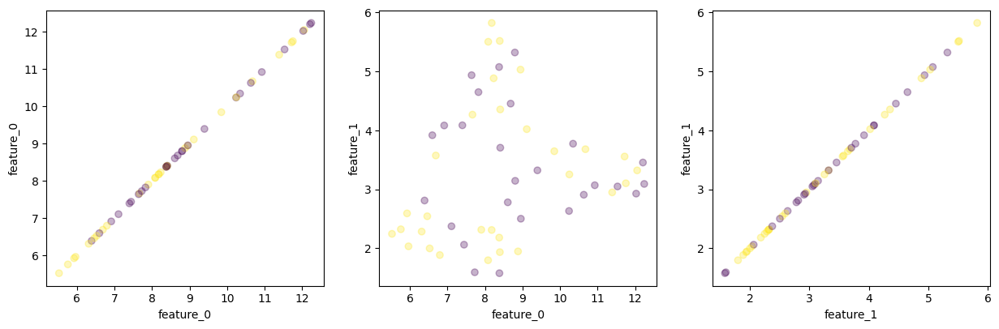

In [ ]:
n_ = 8
n = n_ * 7

w = 7
k = 0
X_2 = test_data[k][0:n]
y_2 = y_test[k][0:n]

plt.rcParams['figure.figsize'] = [15, 15]

umaper(models[k], X_2, y_2)

UMAP, average


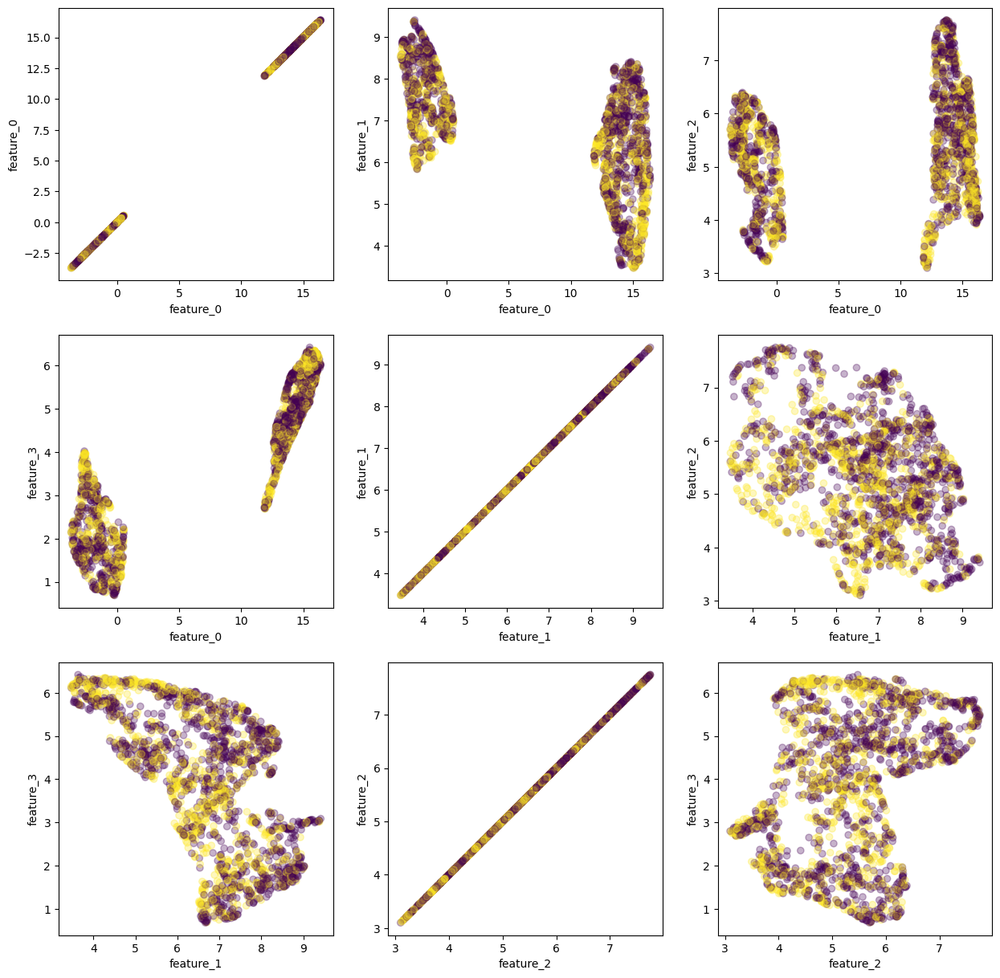

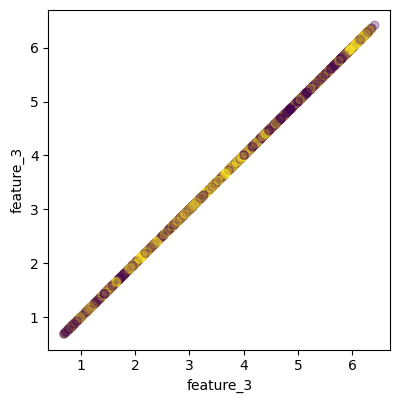

In [ ]:
n_ = 300
n = n_ * 7

w = 7
k = 0
X_2 = test_data[k][0:n]
y_2 = y_test[k][0:n]
ages_2 = ages_[0:n] / 100   # scaling
sexs_2 = sexs_[0:n]

plt.rcParams['figure.figsize'] = [15, 15]

ss = umaper_age_sex(models[k], X_2, y_2, ages_2, sexs_2, n_components=4)

id est: 0
UMAP, average


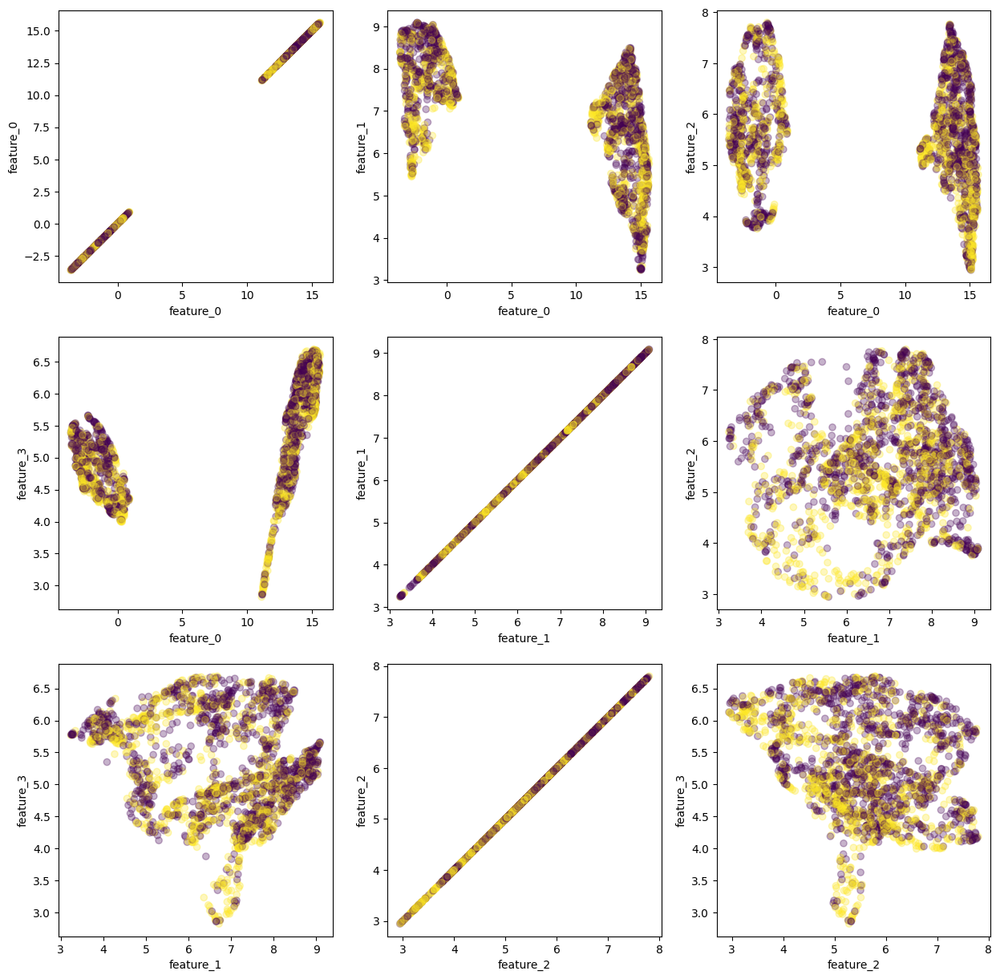

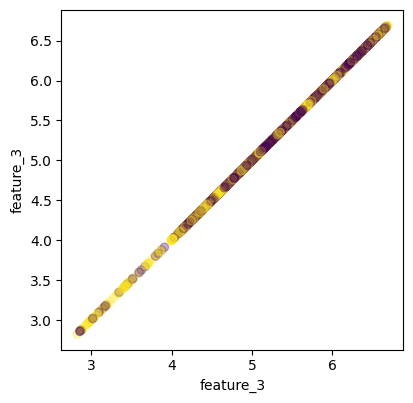

id est: 1
UMAP, average


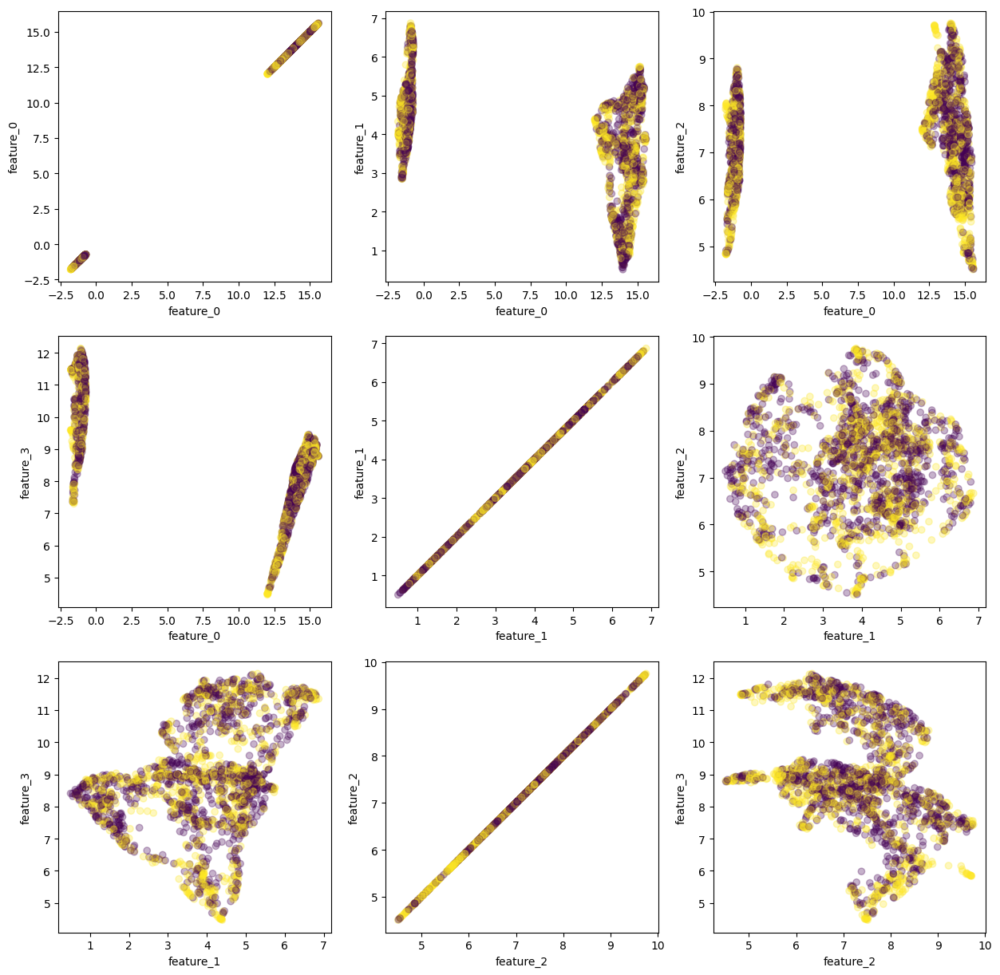

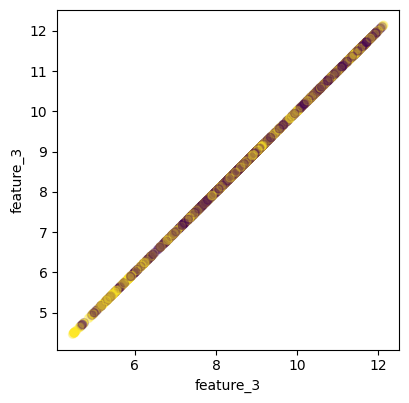

id est: 2
UMAP, average


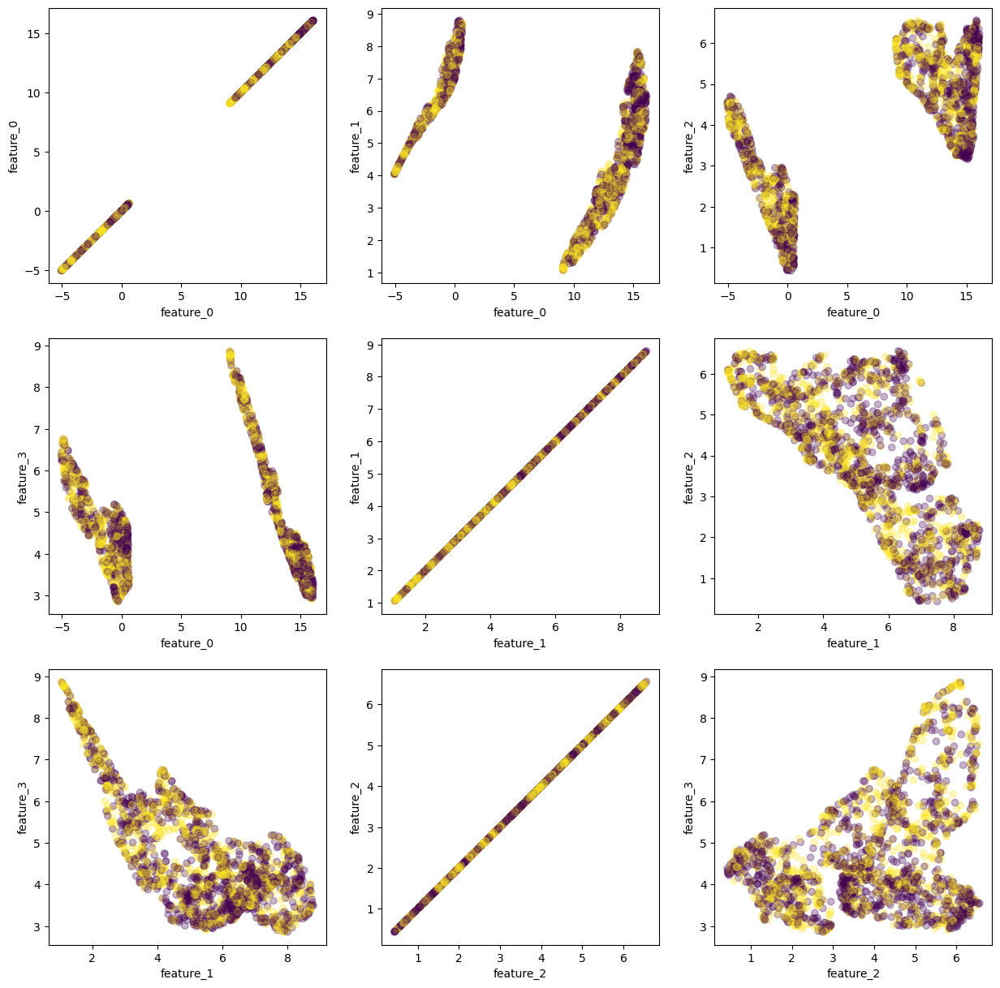

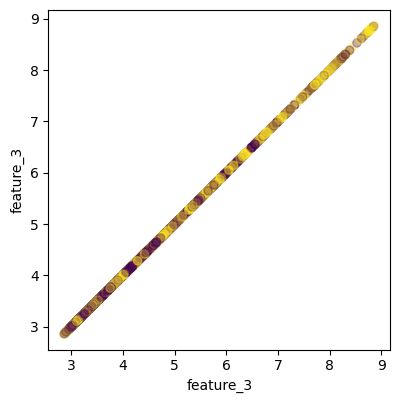

id est: 3
UMAP, average


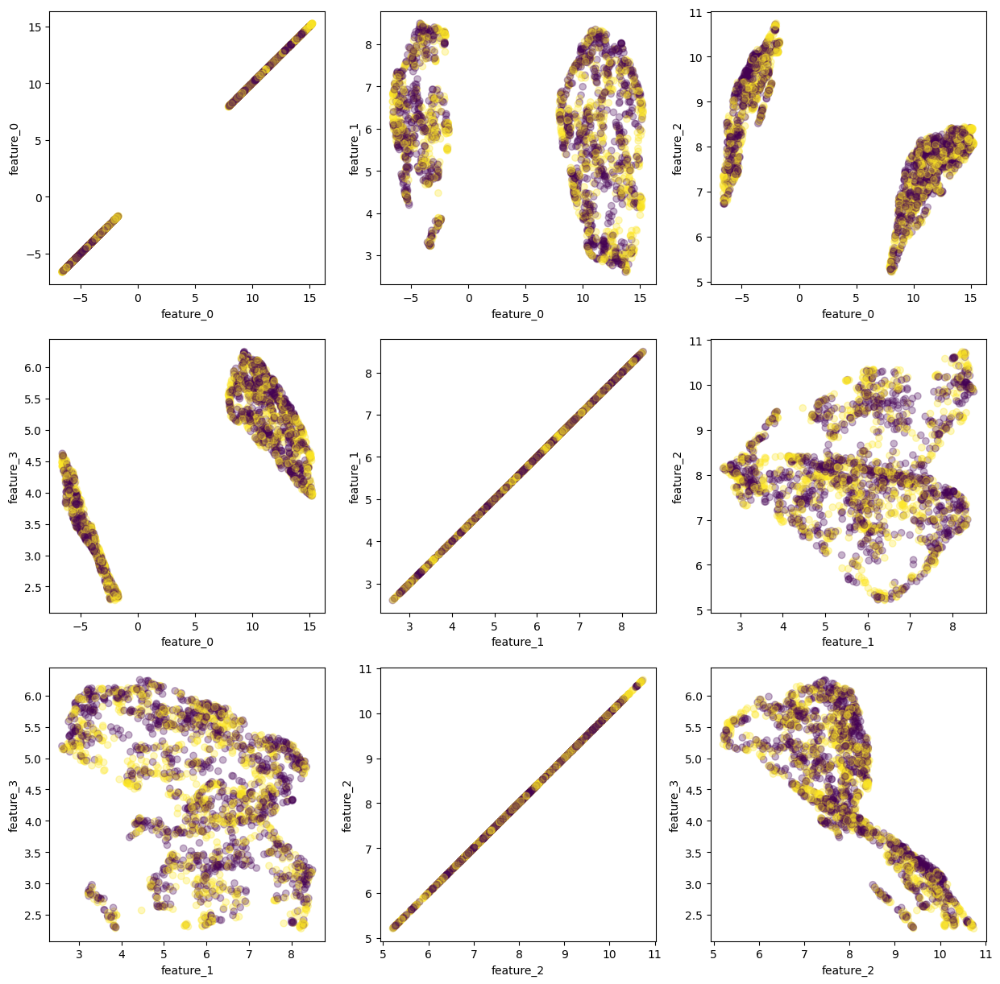

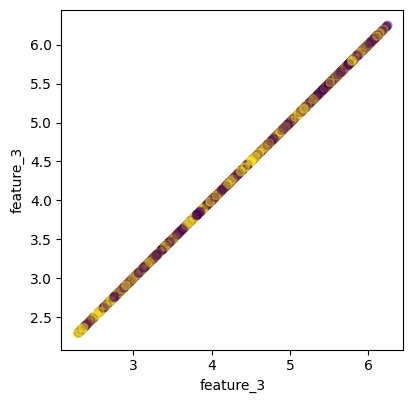

id est: 4
UMAP, average


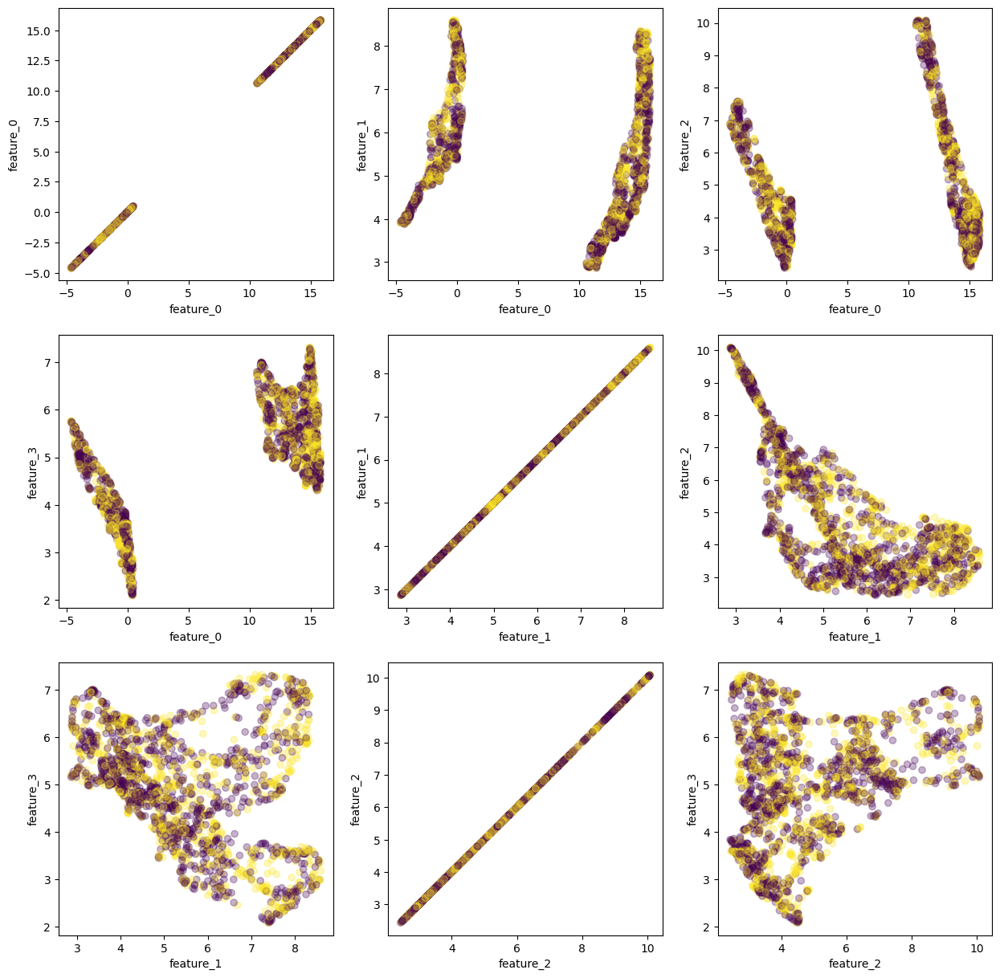

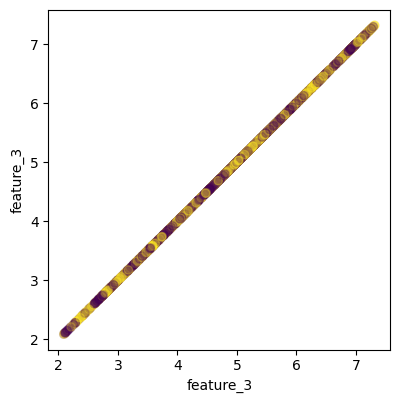

id est: 5
UMAP, average


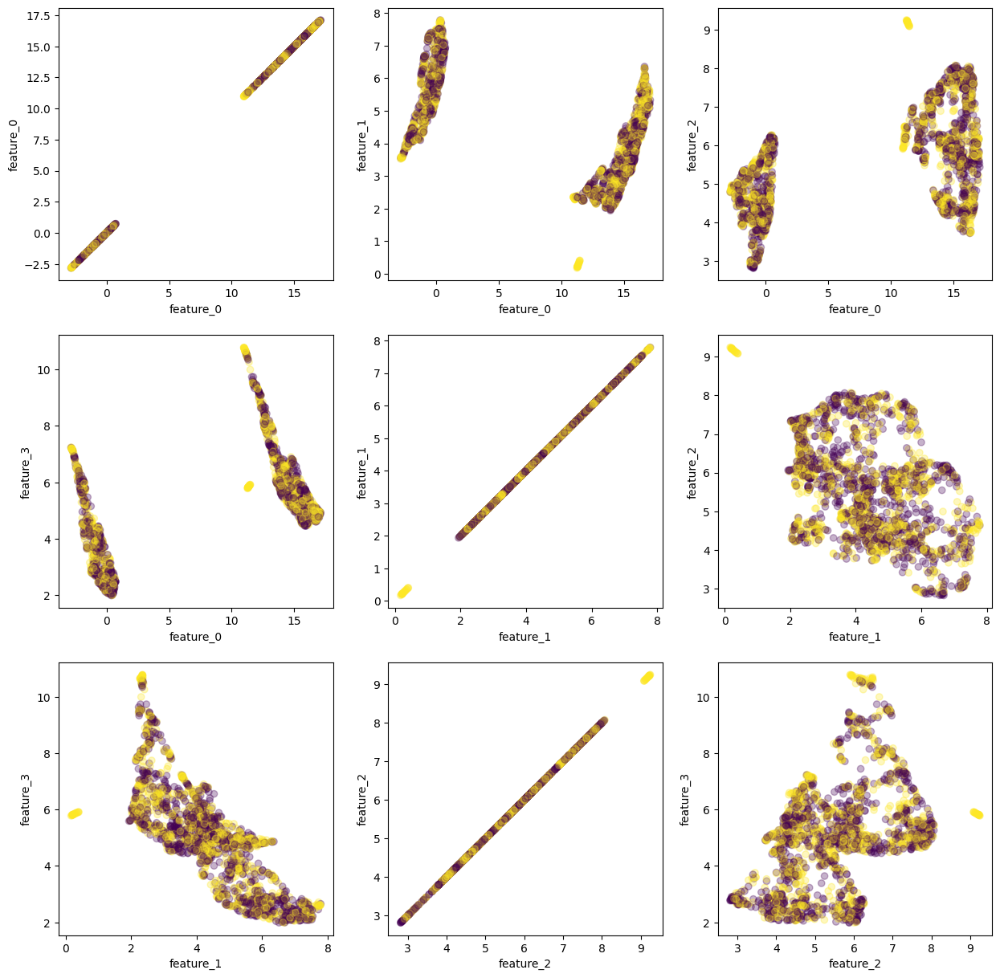

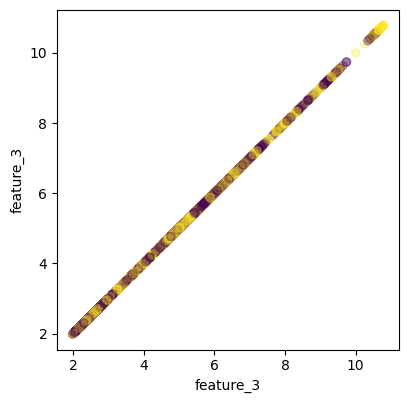

id est: 6
UMAP, average


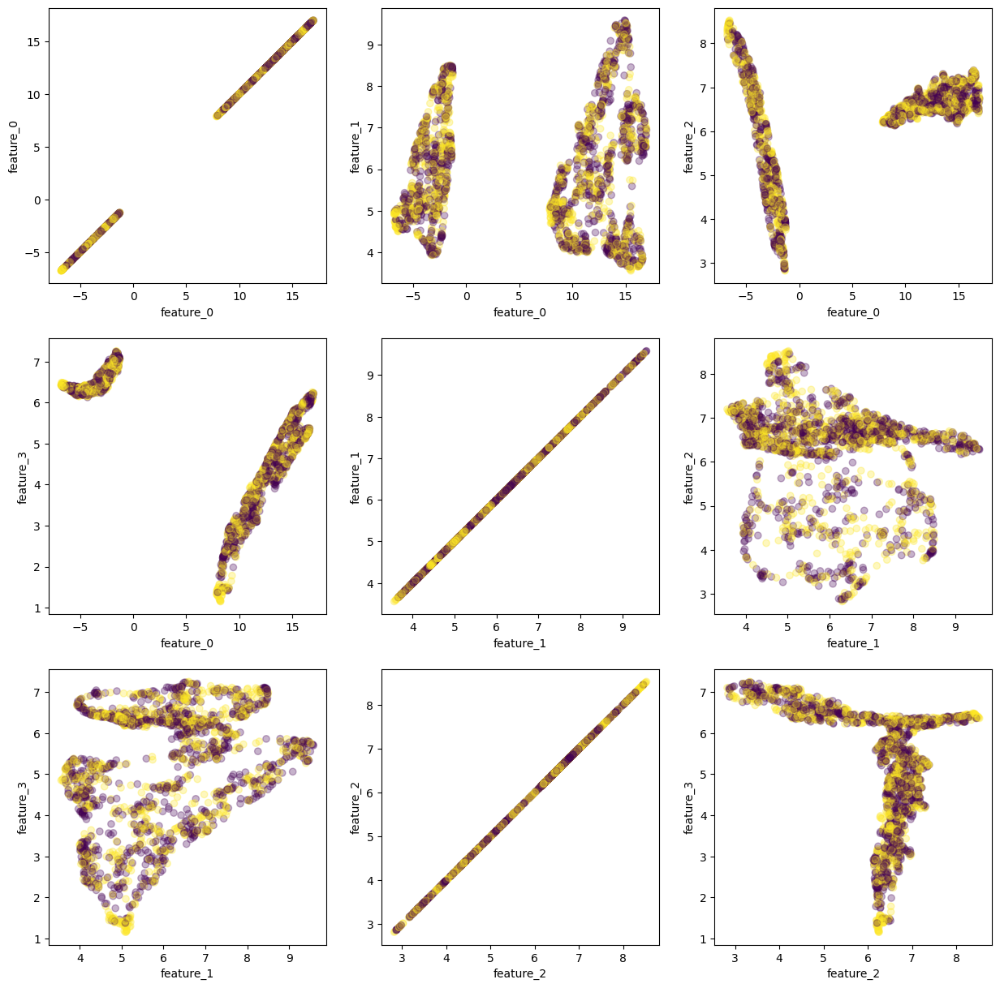

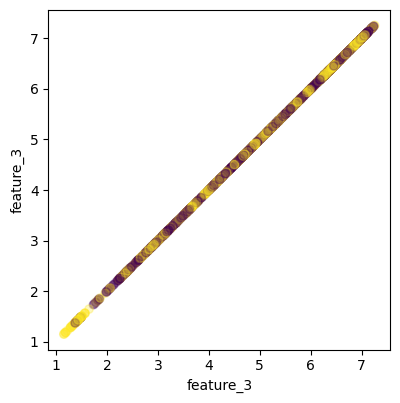

id est: 7
UMAP, average


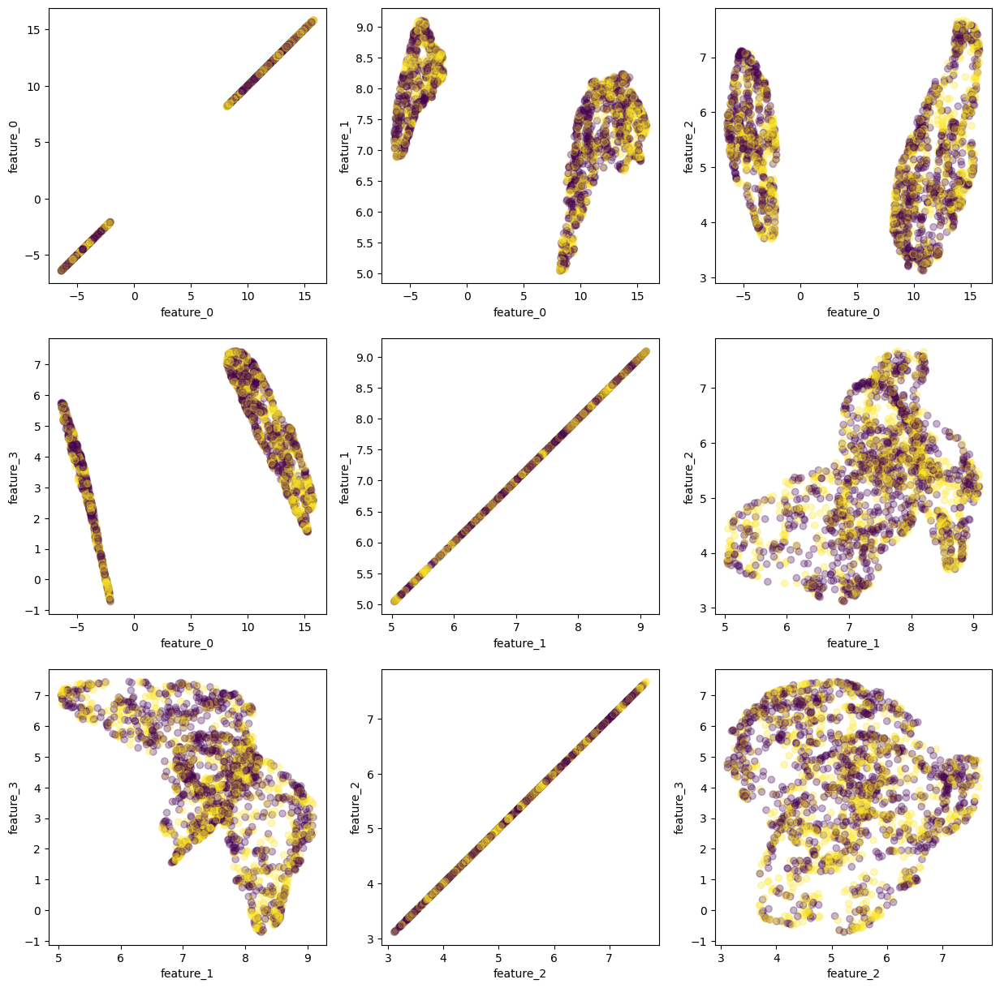

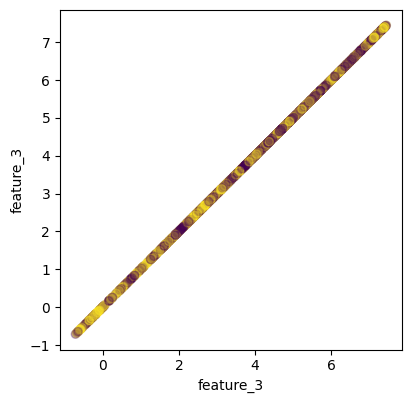

id est: 8
UMAP, average


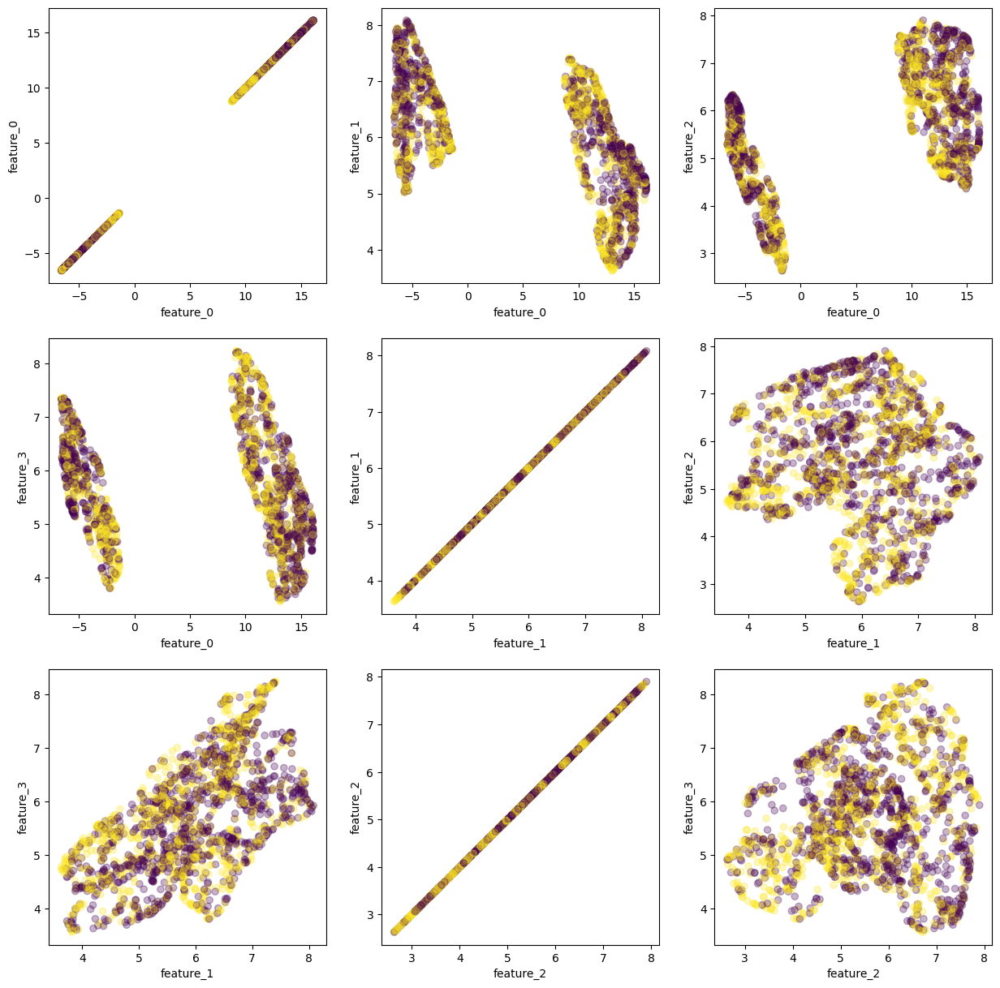

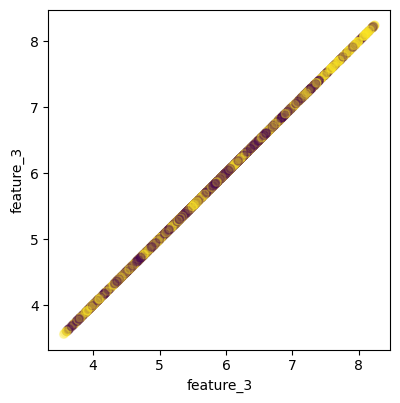

id est: 9
UMAP, average


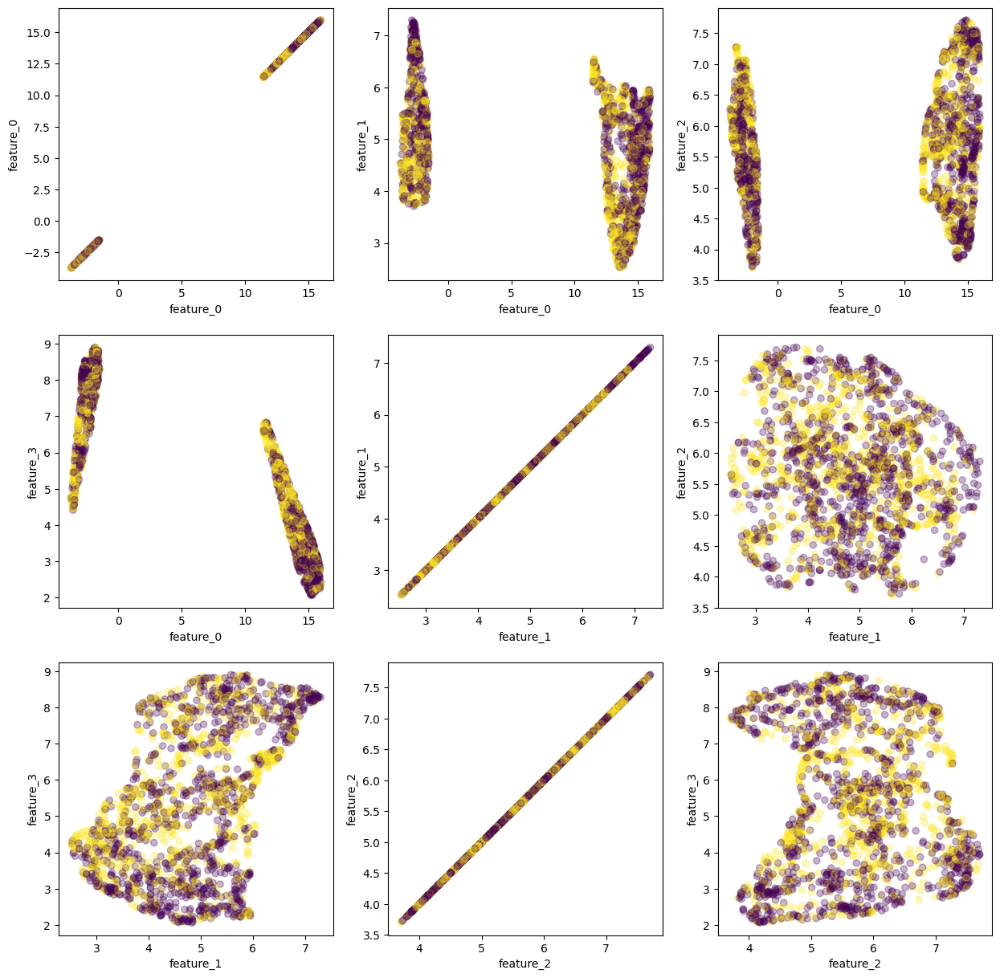

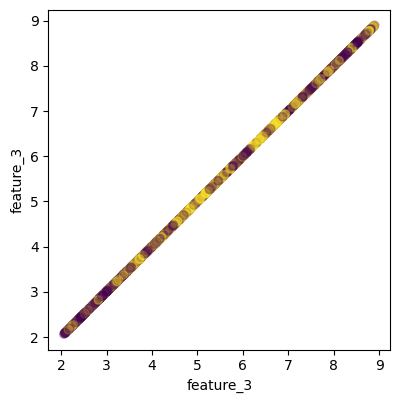

id est: 10
UMAP, average


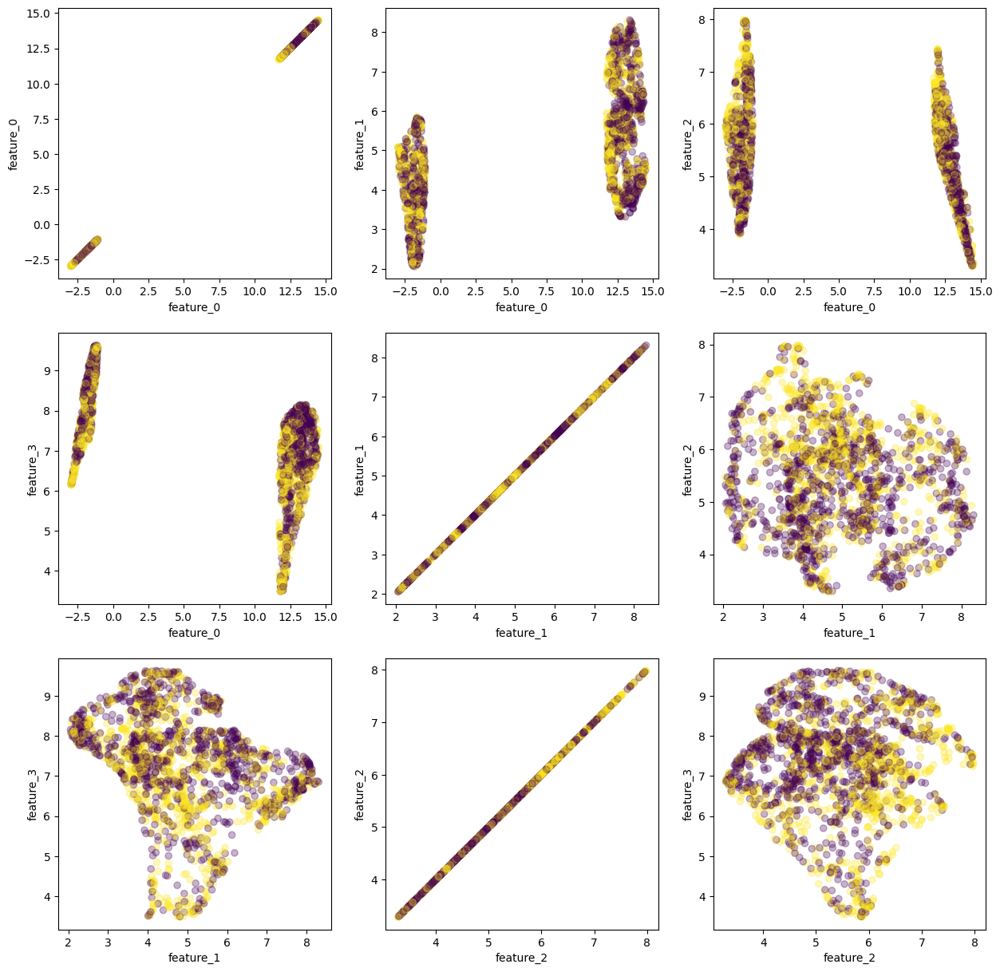

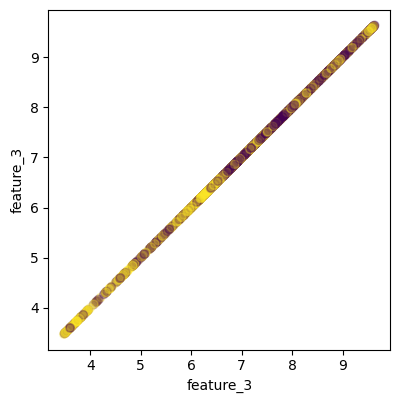

id est: 11
UMAP, average


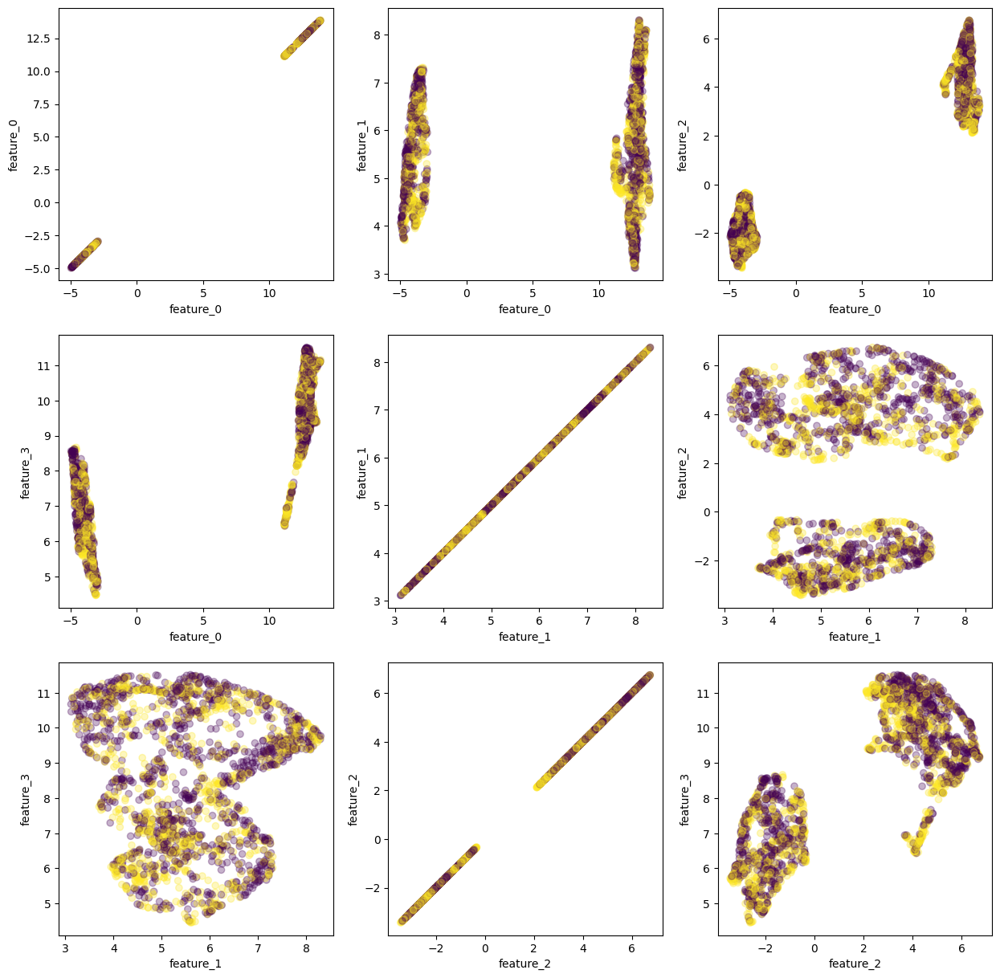

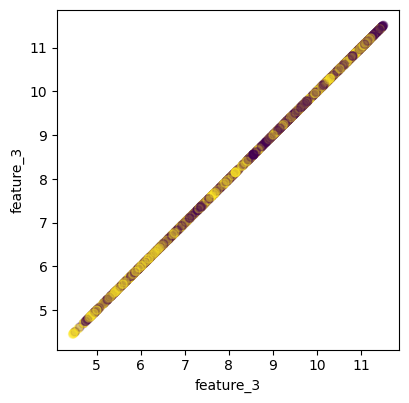

In [192]:
for i in range(12):
    n_ = 300
    n = n_ * 7

    w = 7
    X_2 = test_data[i][0:n]
    y_2 = y_test[i][0:n]
    ages_2 = ages_[0:n] / 100   # scaling
    sexs_2 = sexs_[0:n]

    plt.rcParams['figure.figsize'] = [15, 15]

    print("id est:", i)
    umaper_age_sex(models[k], X_2, y_2, ages_2, sexs_2, n_components=4)

id est: 0
UMAP-PCA, average


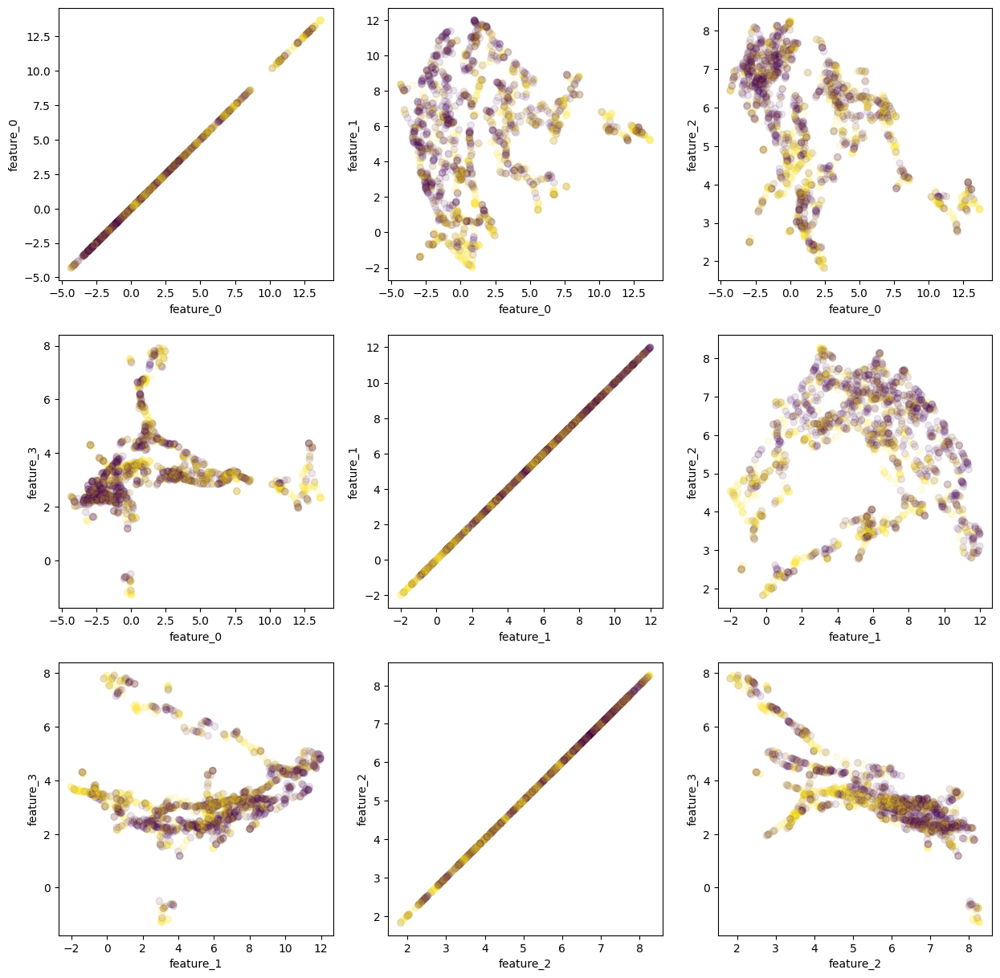

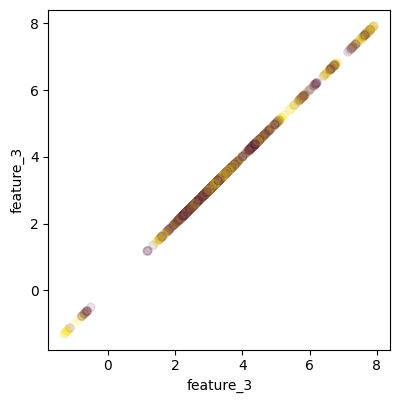

id est: 1
UMAP-PCA, average


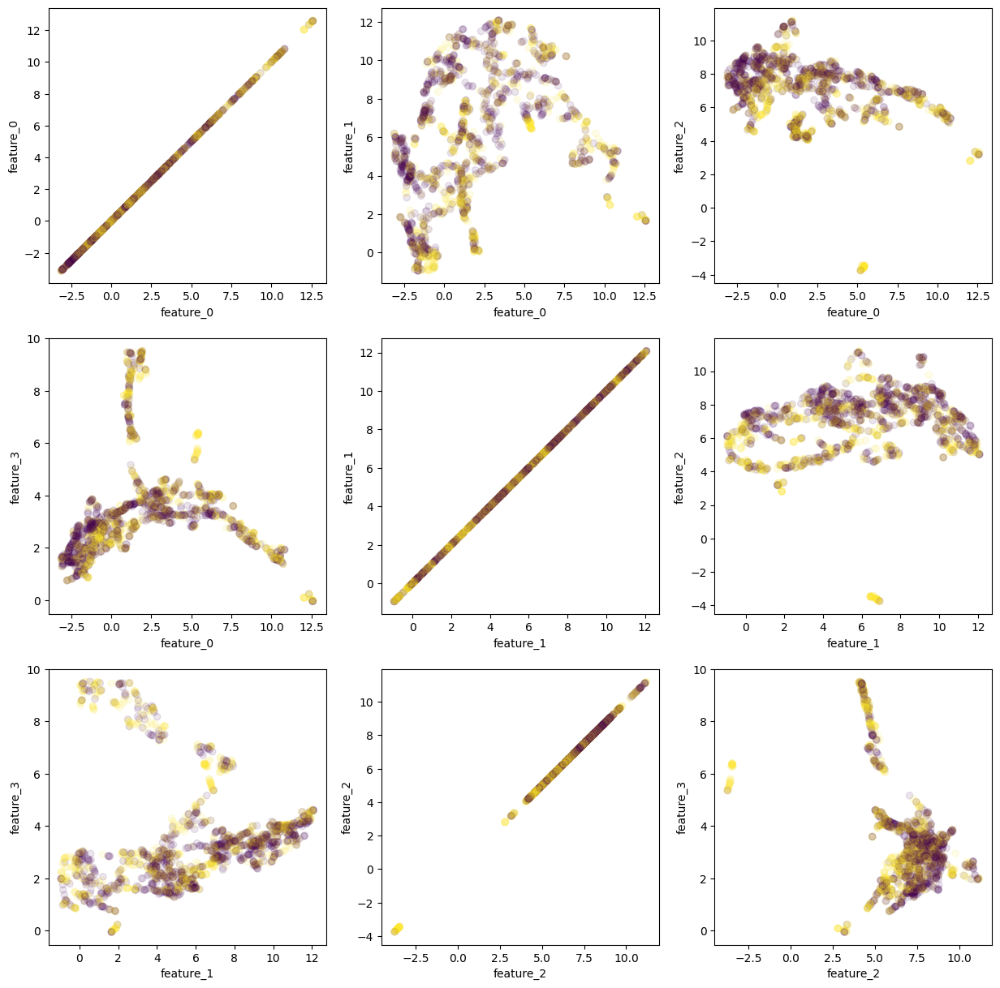

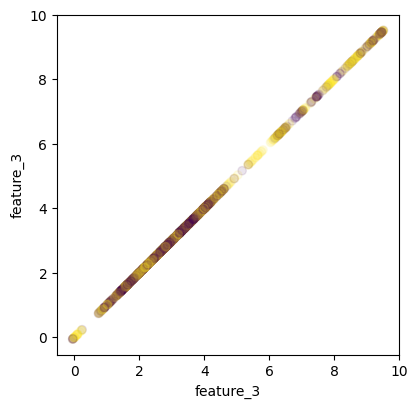

id est: 2
UMAP-PCA, average


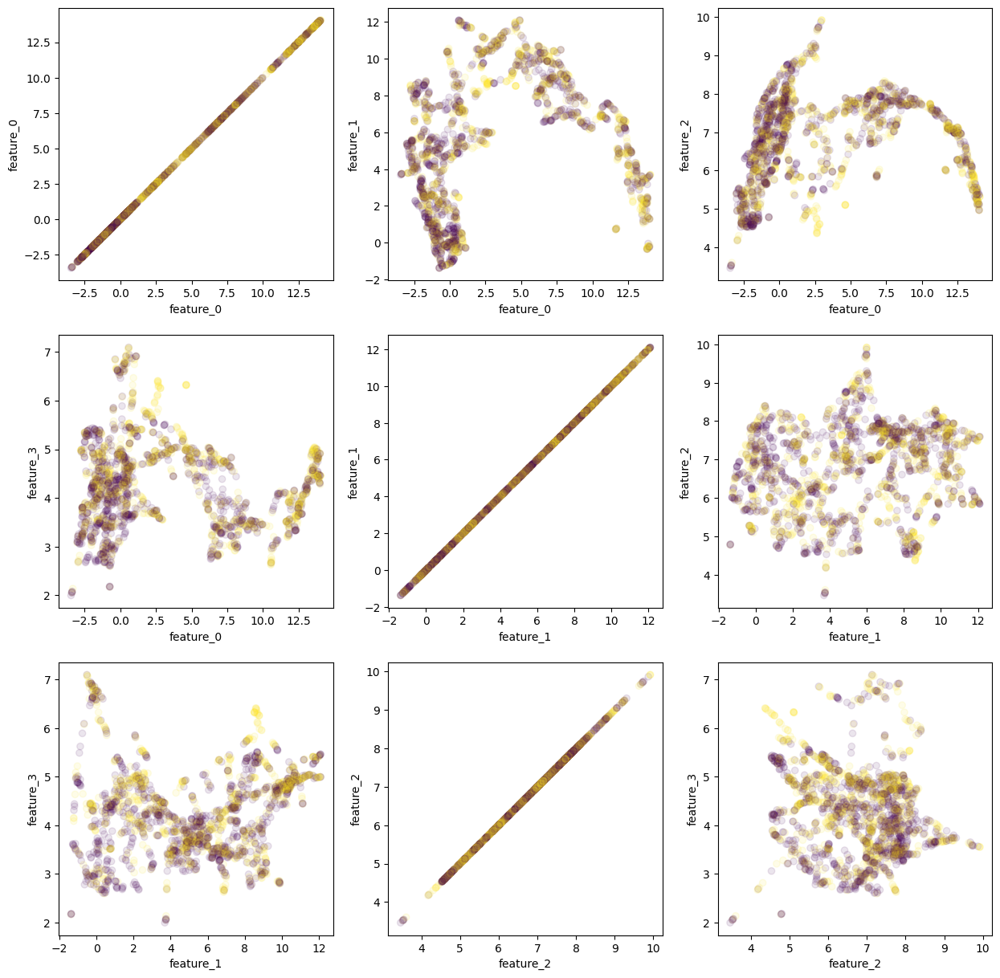

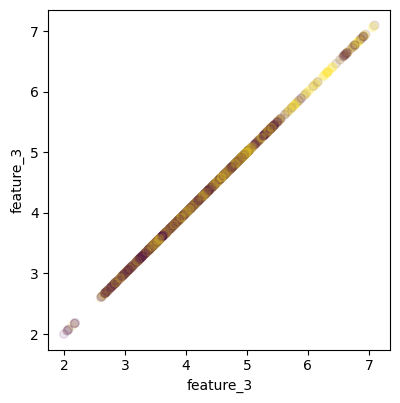

id est: 3
UMAP-PCA, average


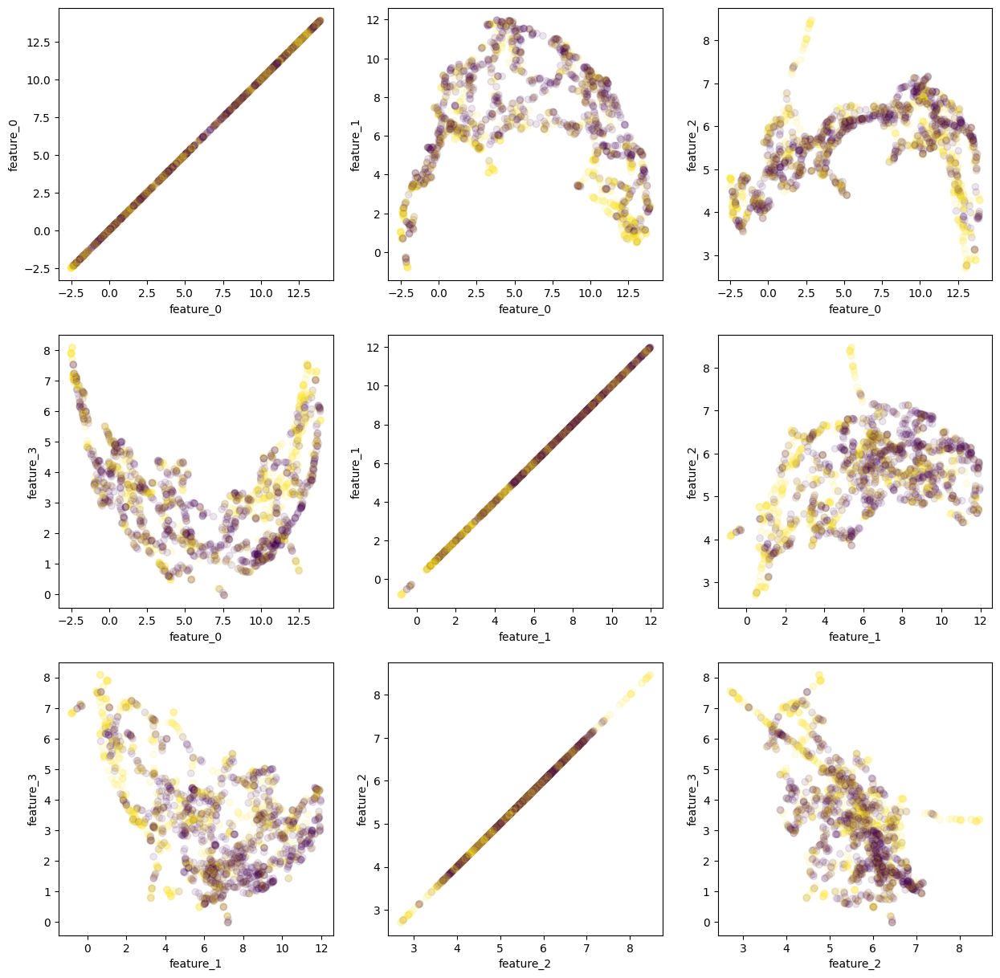

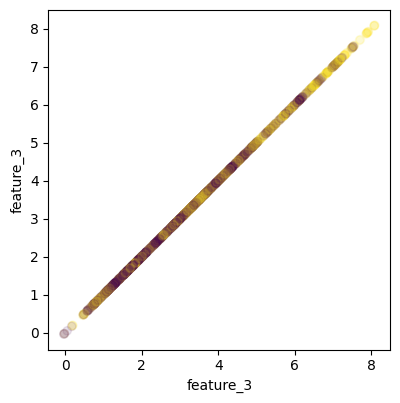

id est: 4
UMAP-PCA, average


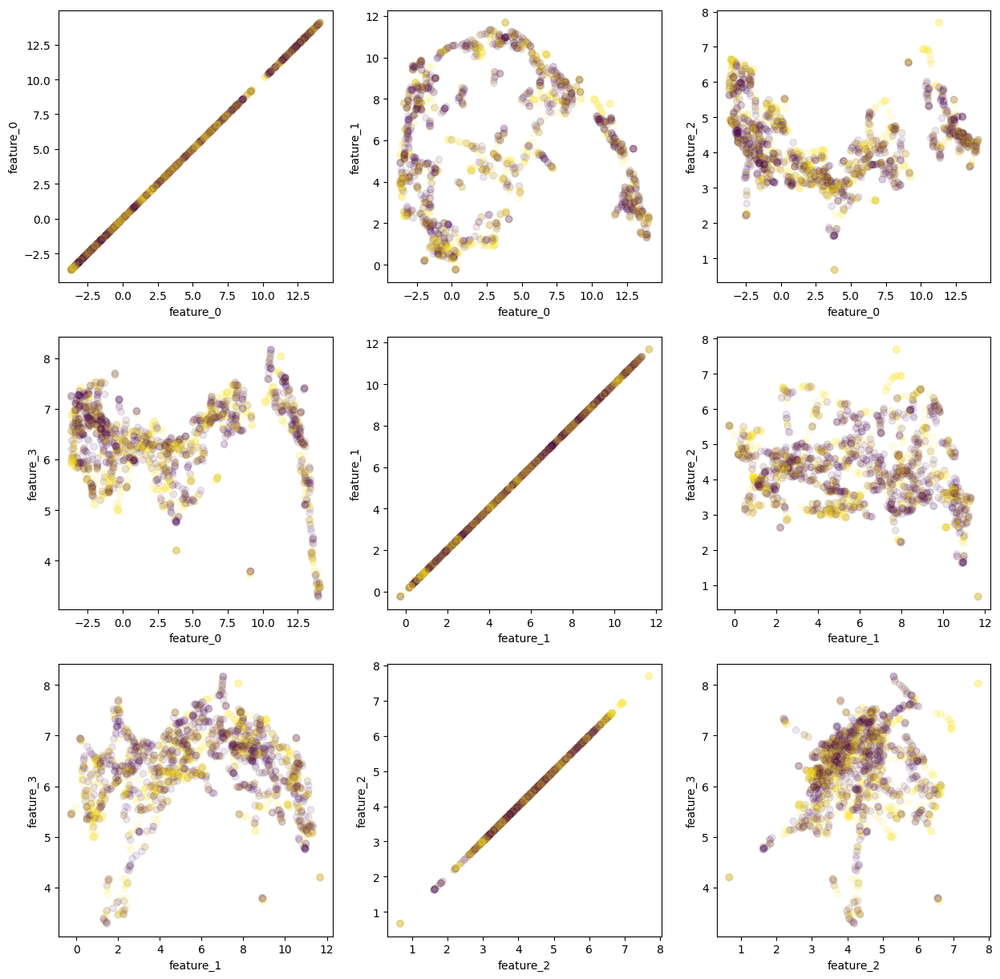

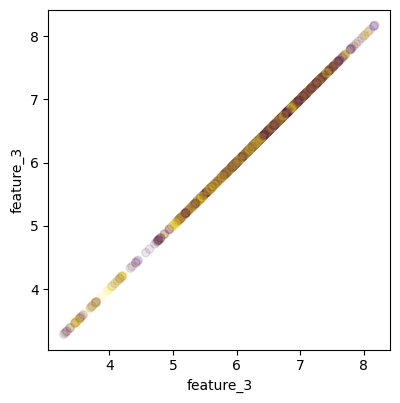

id est: 5
UMAP-PCA, average


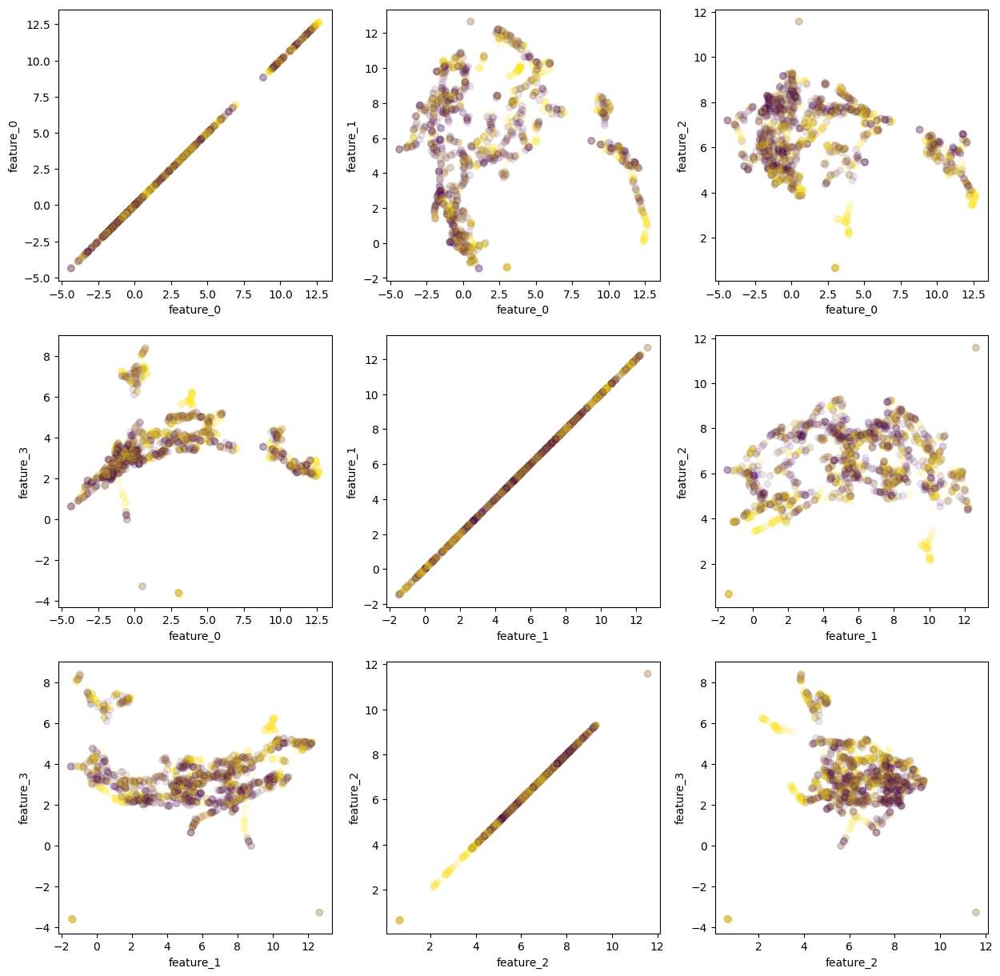

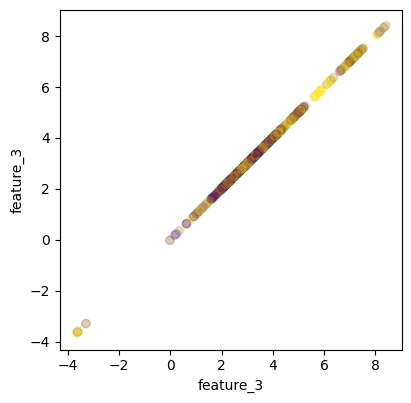

id est: 6
UMAP-PCA, average


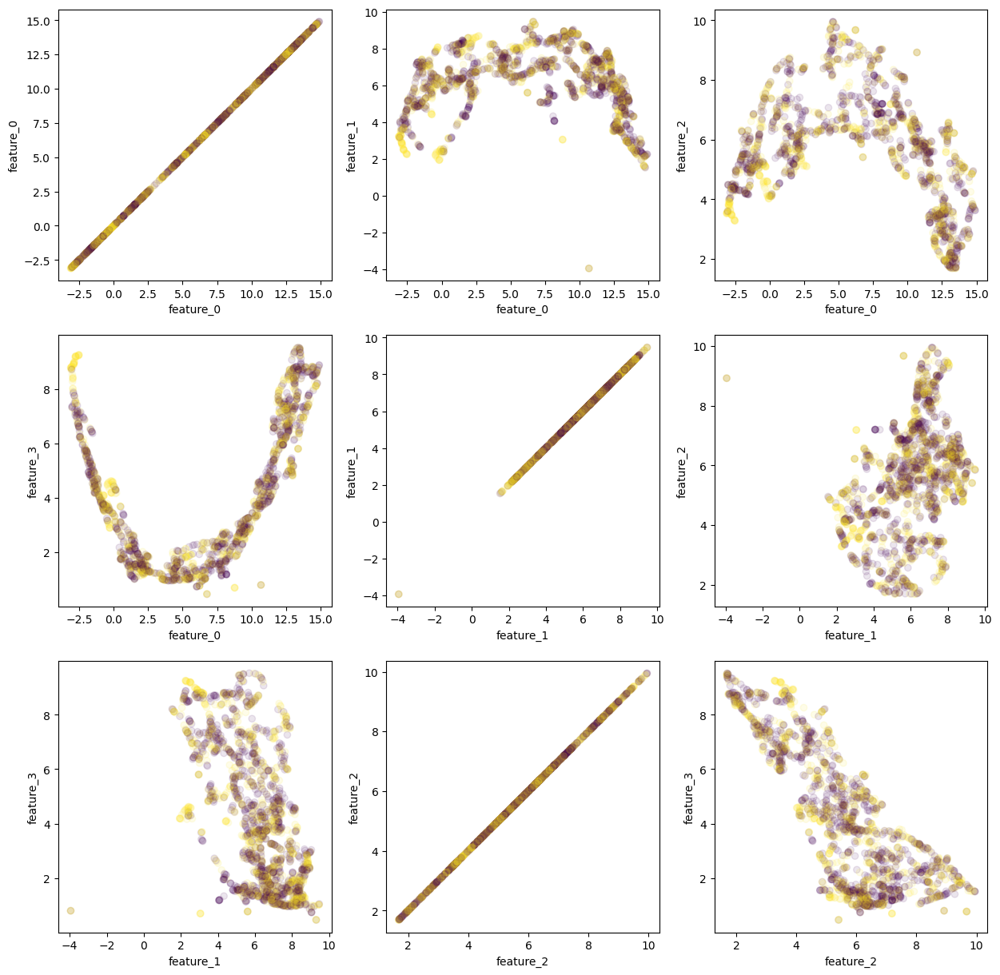

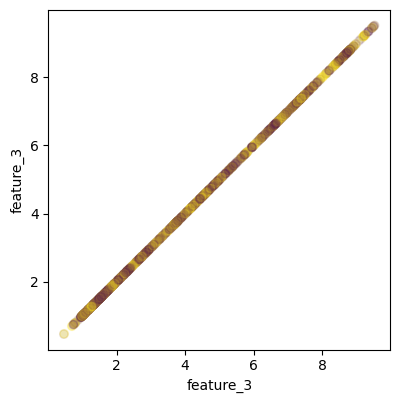

id est: 7
UMAP-PCA, average


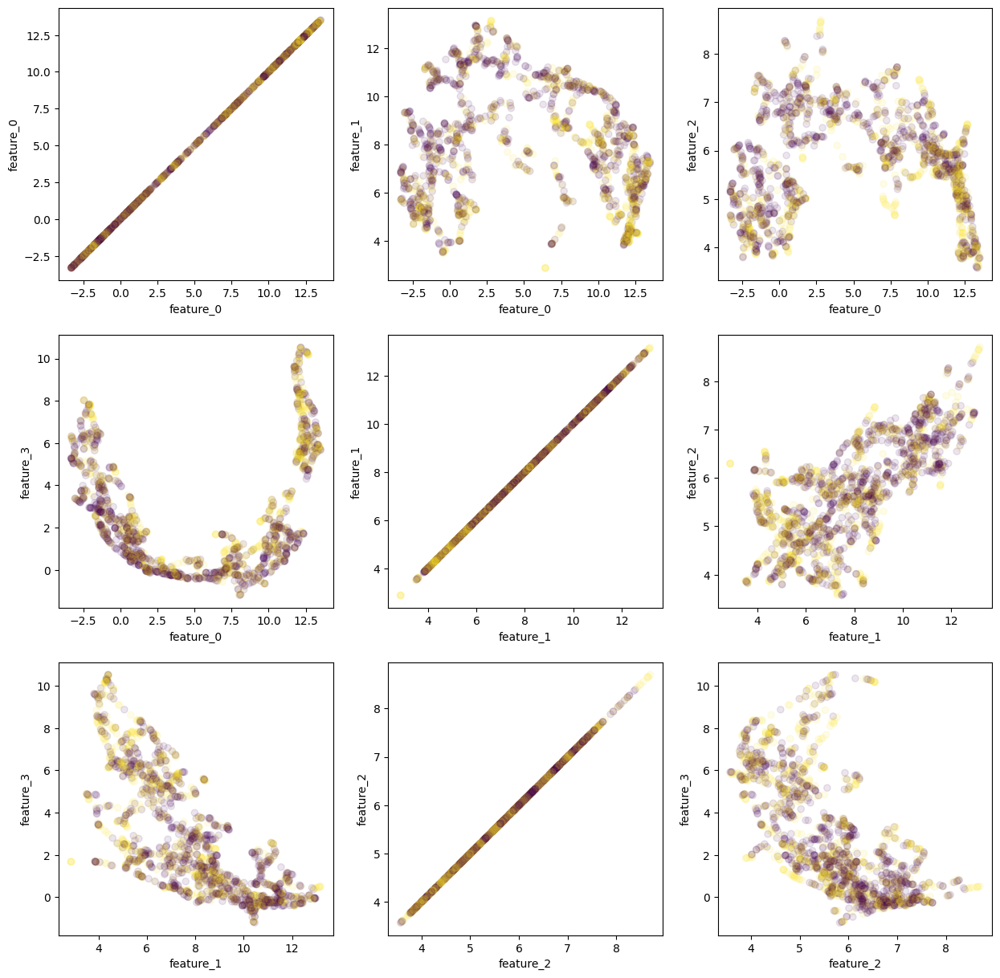

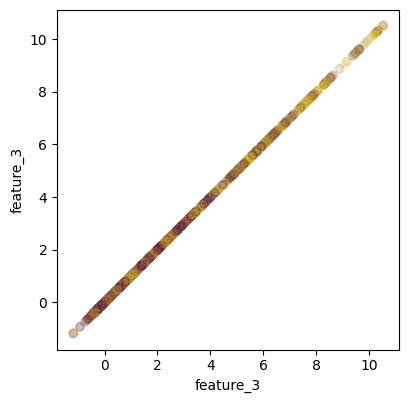

id est: 8
UMAP-PCA, average


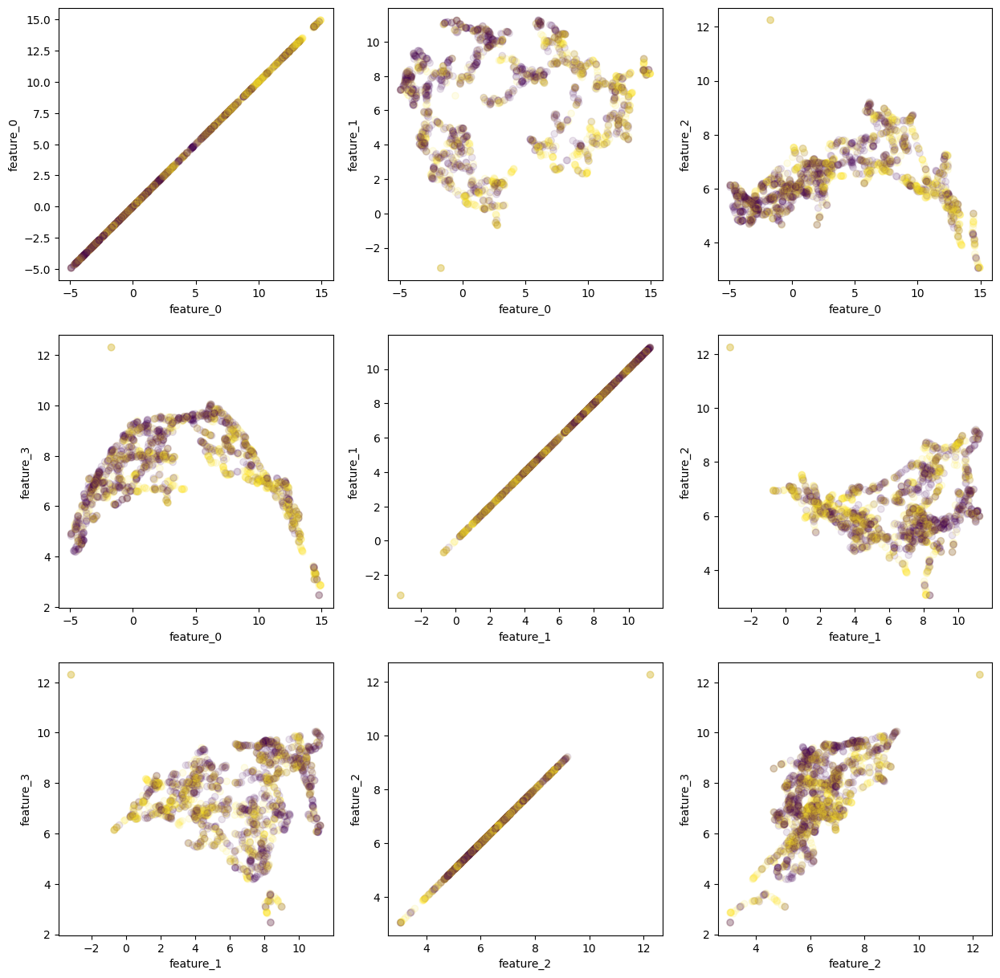

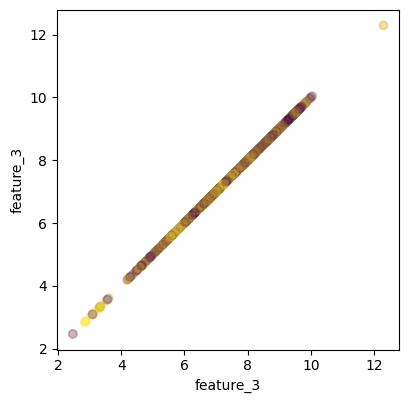

id est: 9
UMAP-PCA, average


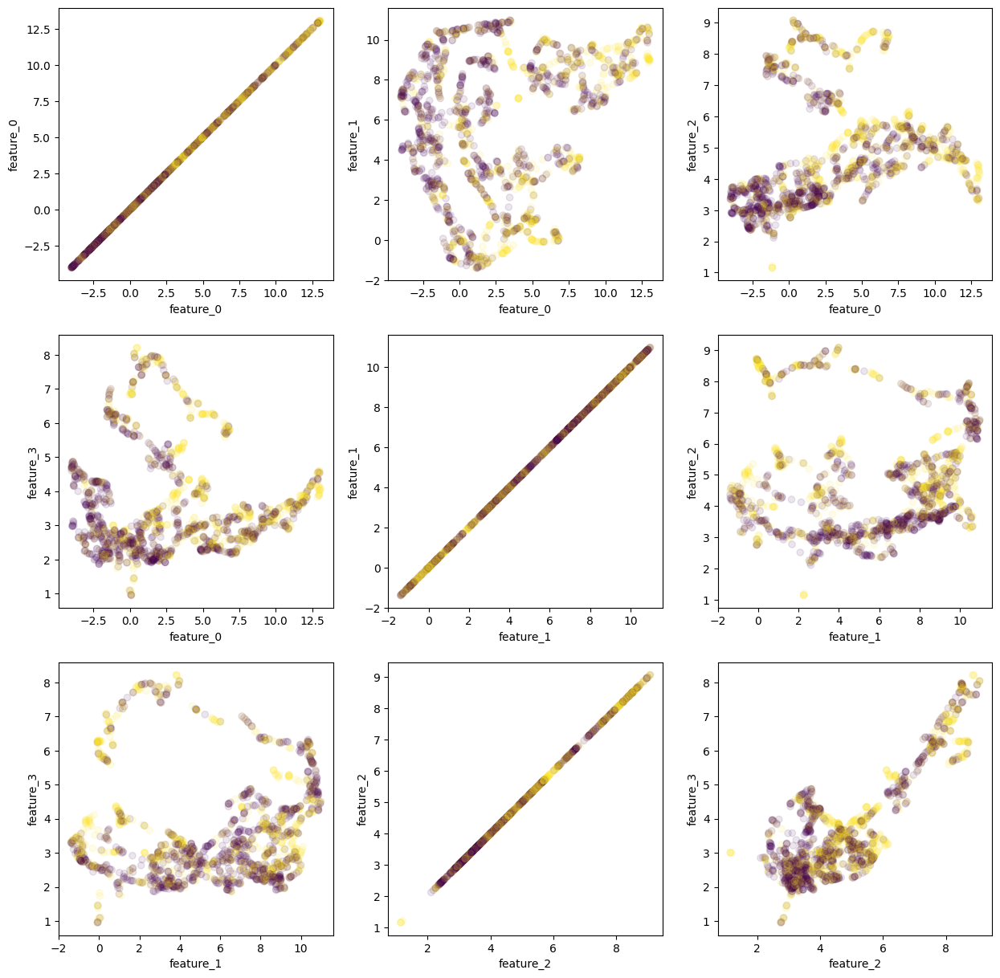

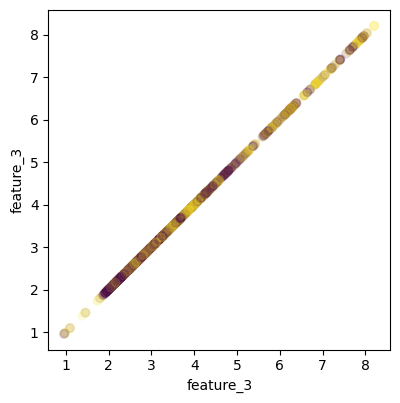

id est: 10
UMAP-PCA, average


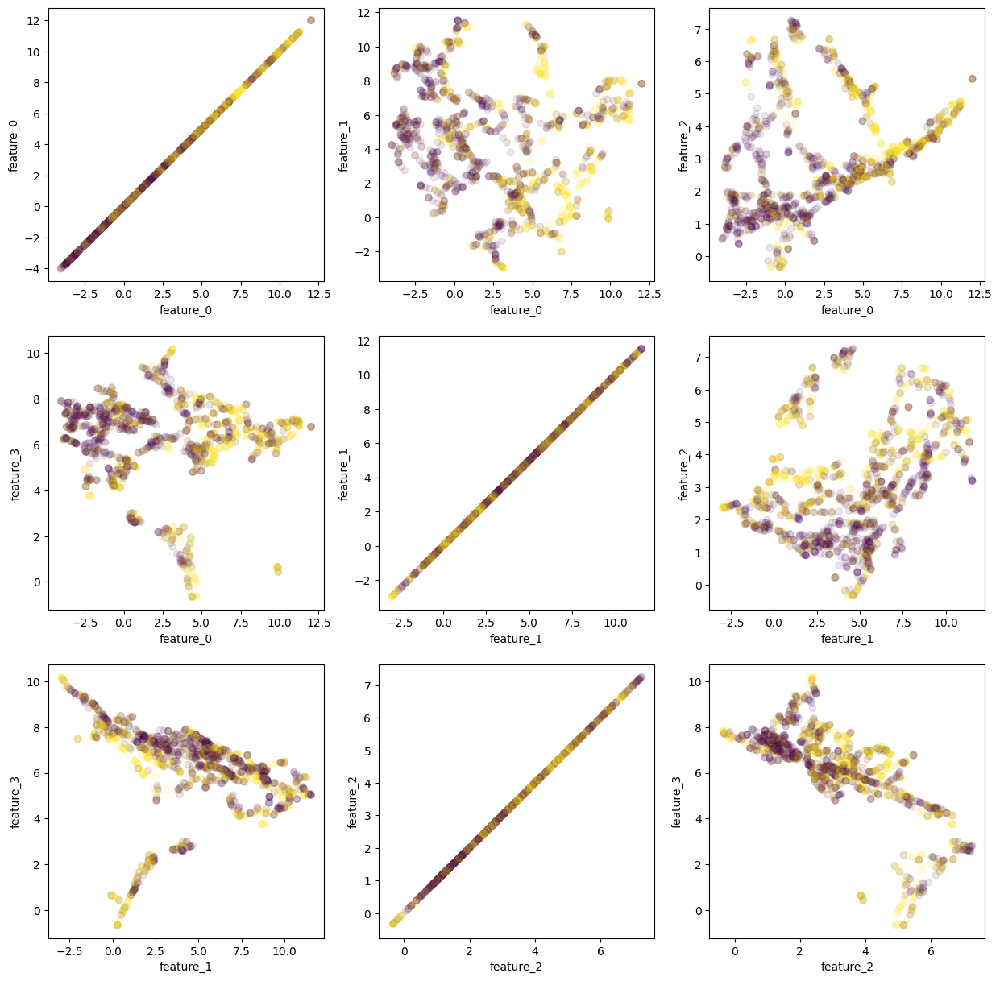

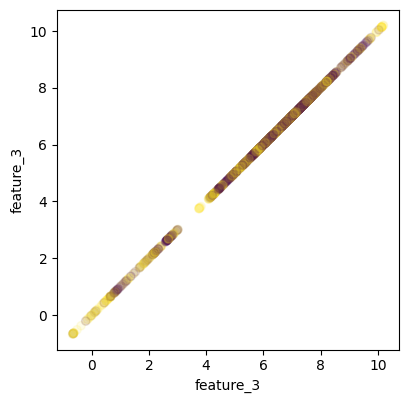

id est: 11
UMAP-PCA, average


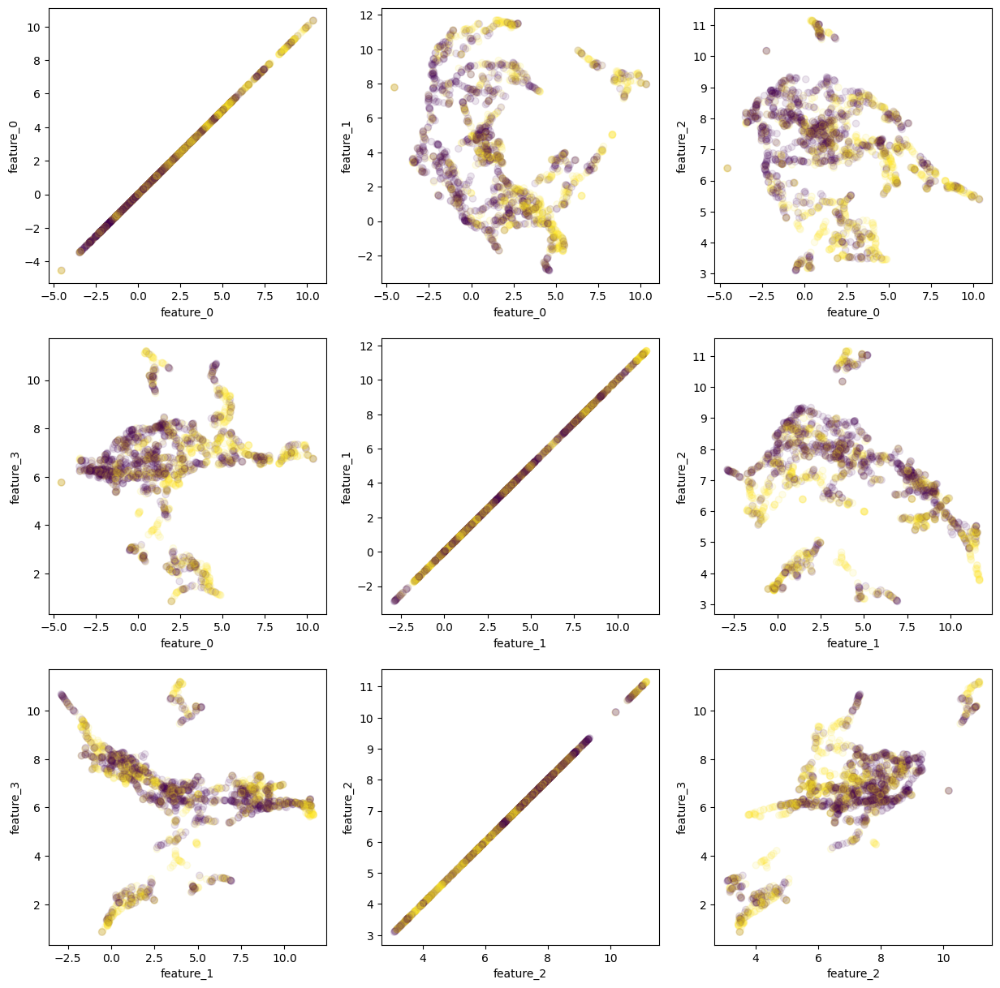

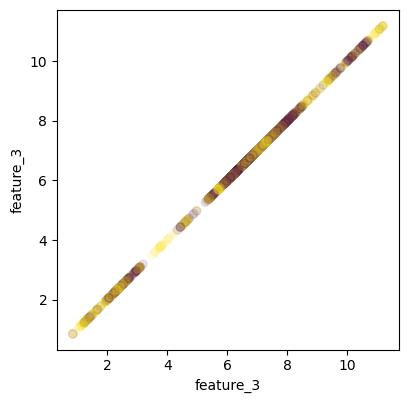

In [195]:
for i in range(12):
    n_ = 300
    n = n_ * 7

    w = 7
    X_2 = test_data[i][0:n]
    y_2 = y_test[i][0:n]
    ages_2 = ages_[0:n] / 100   # scaling
    sexs_2 = sexs_[0:n]

    plt.rcParams['figure.figsize'] = [15, 15]

    print("id est:", i)
    umaper_pca_age_sex(models[k], X_2, y_2, ages_2, sexs_2, n_components=4, alpha=0.1)

id est: 0
UMAP-PCA, average


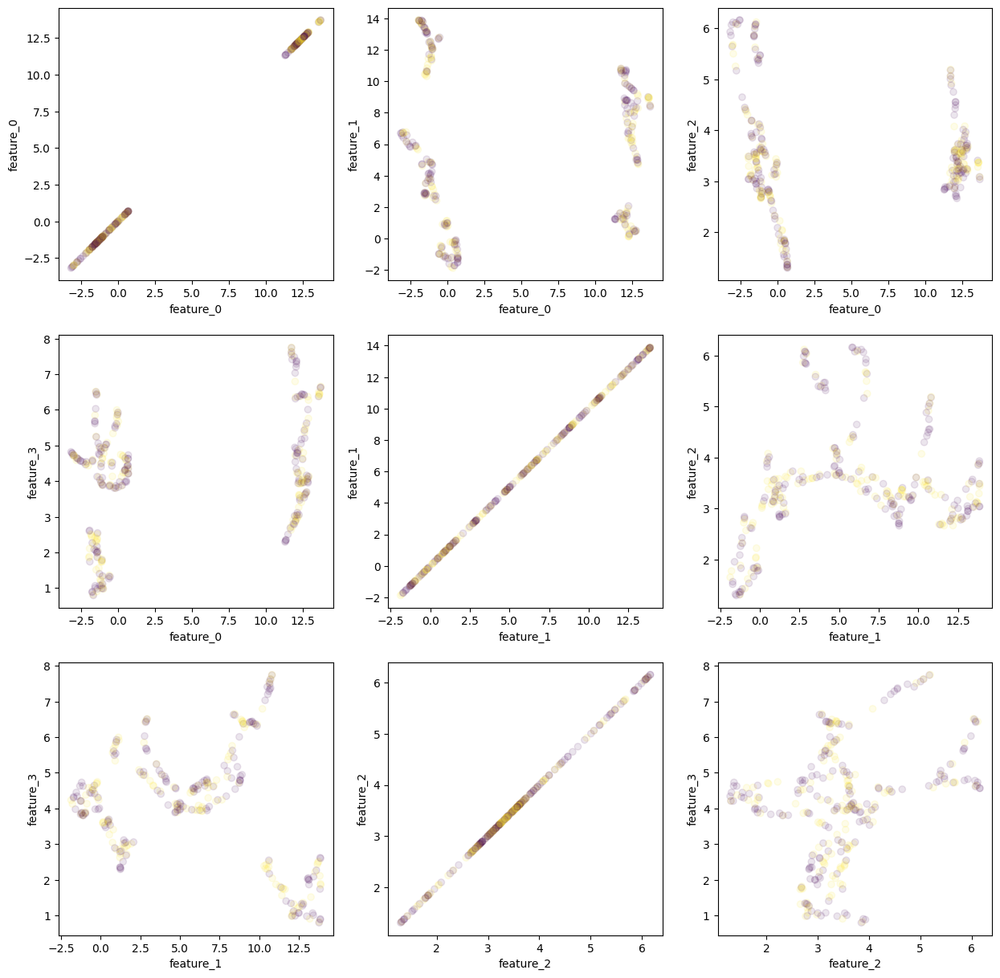

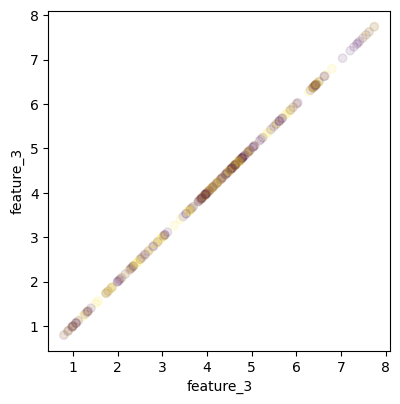

id est: 1
UMAP-PCA, average


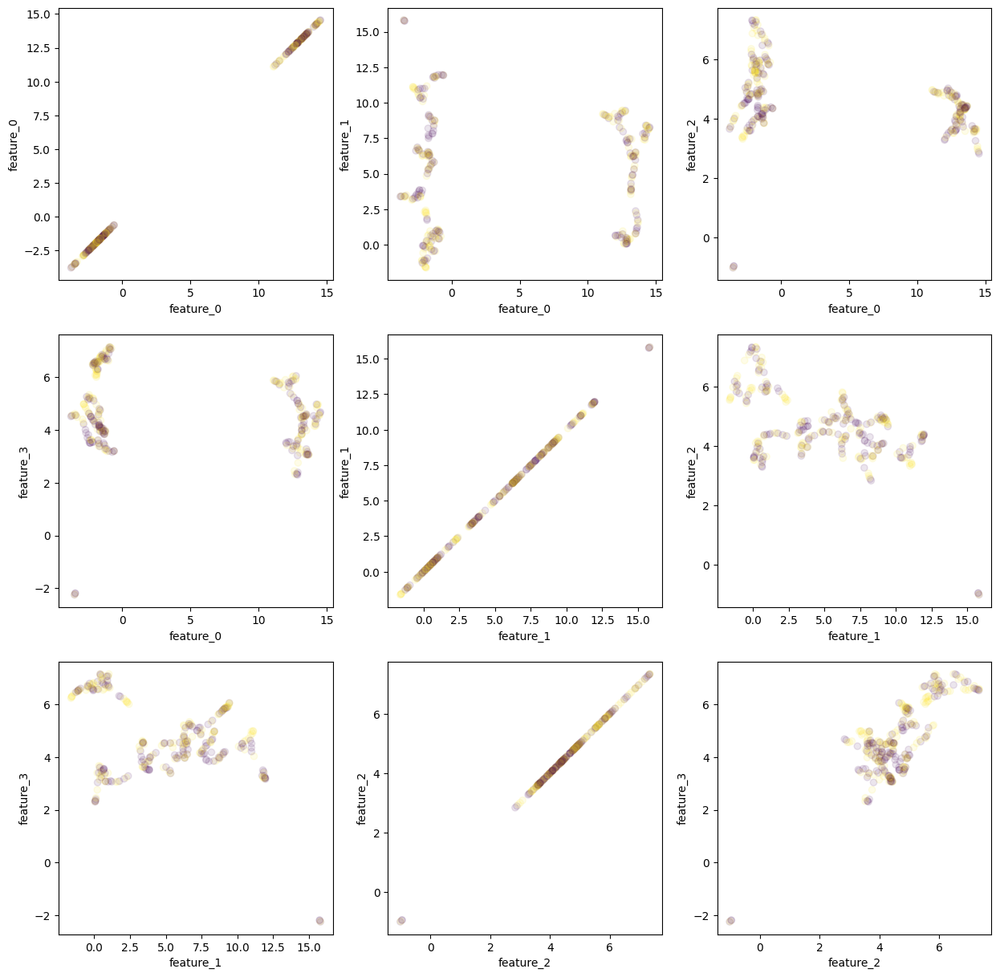

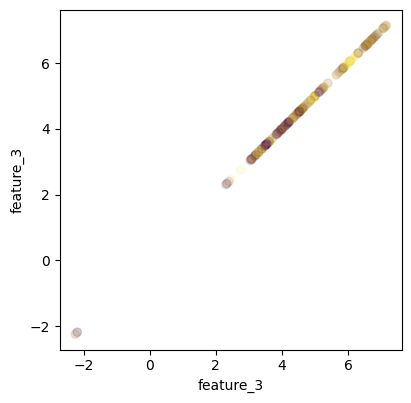

id est: 2
UMAP-PCA, average


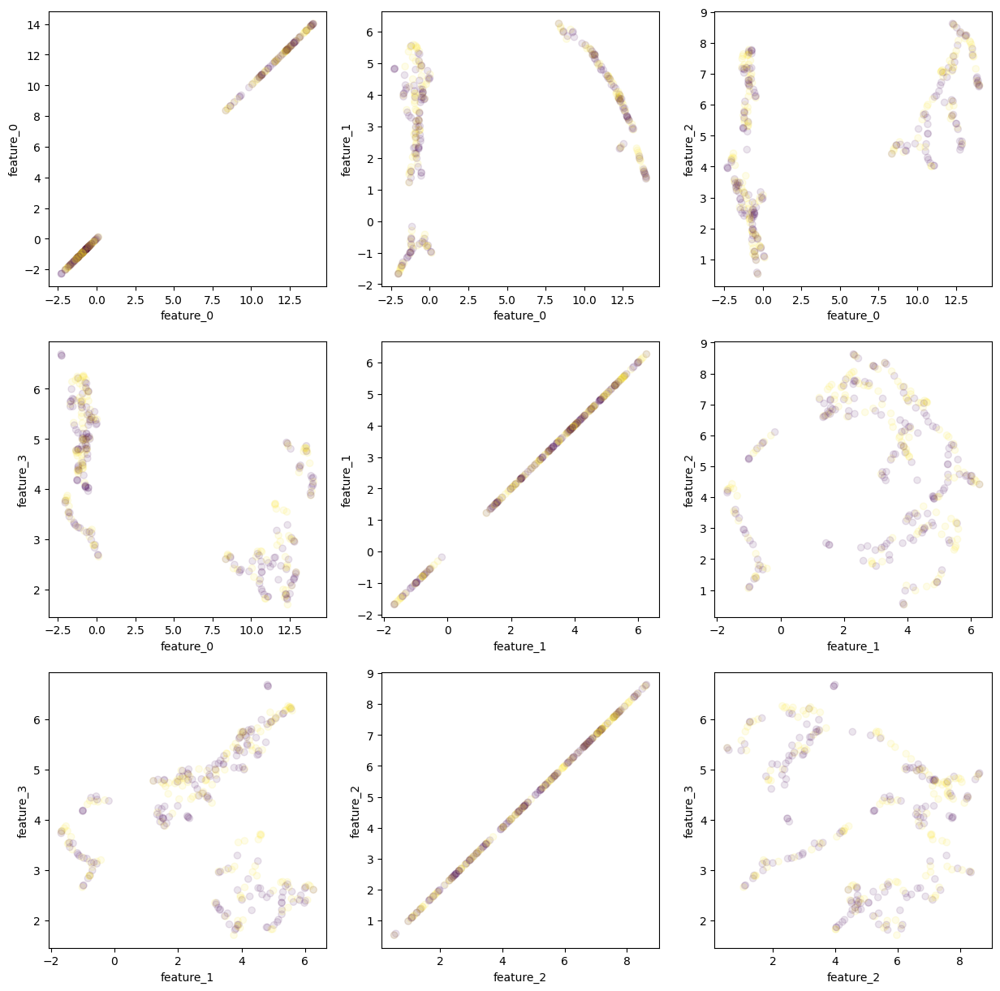

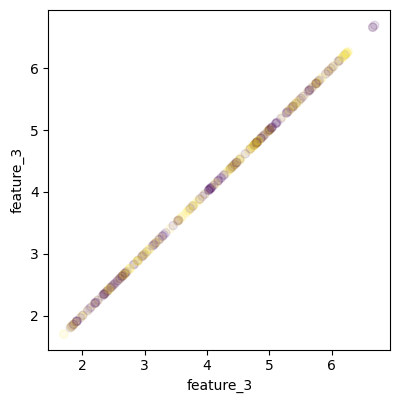

id est: 3
UMAP-PCA, average


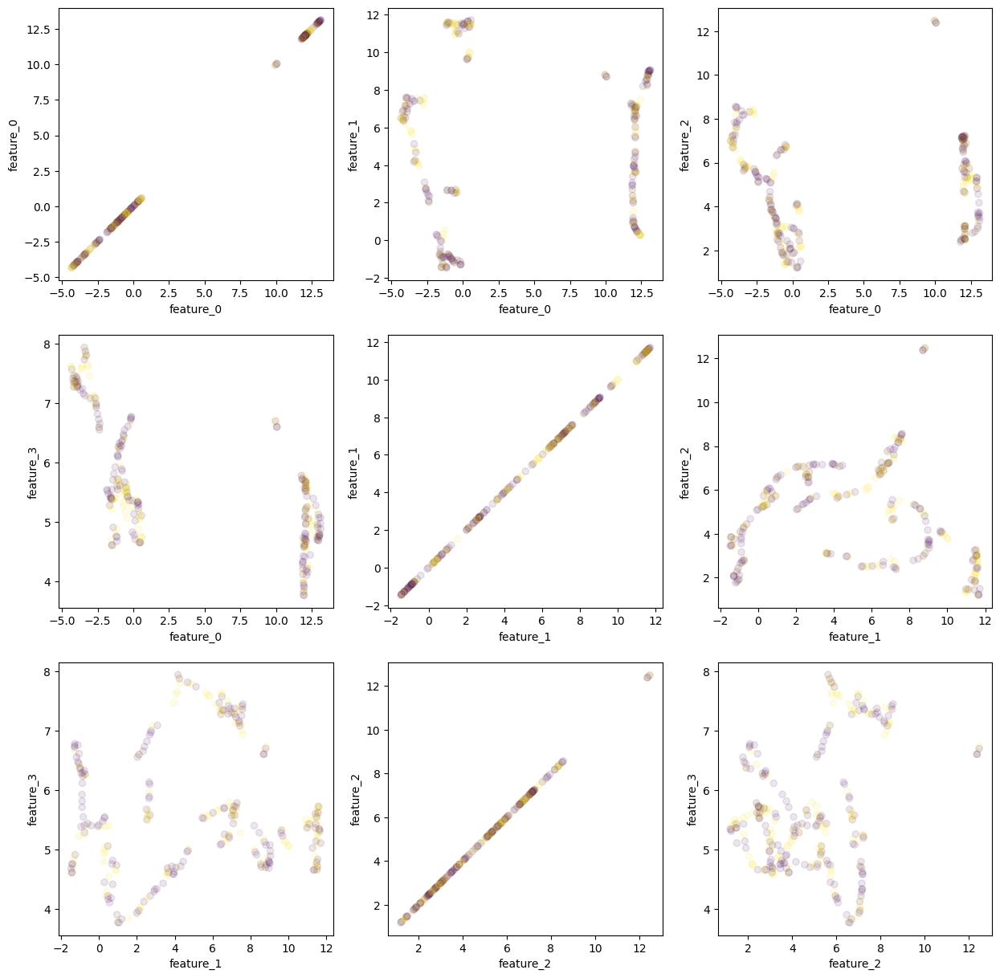

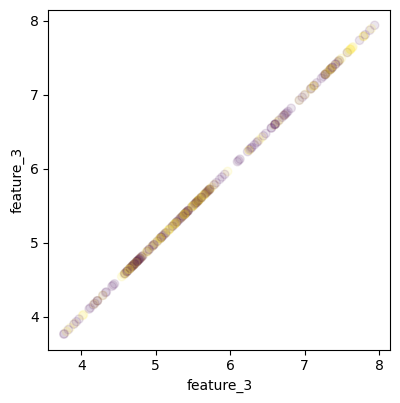

id est: 4
UMAP-PCA, average


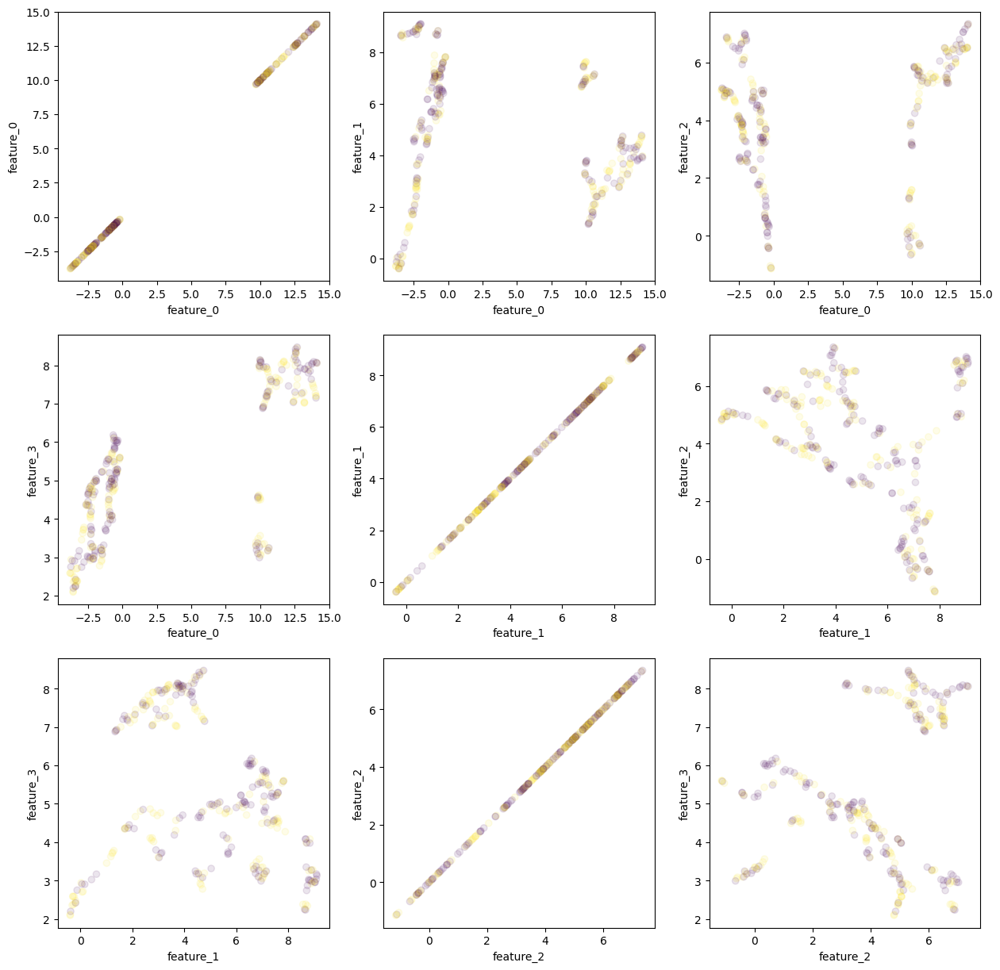

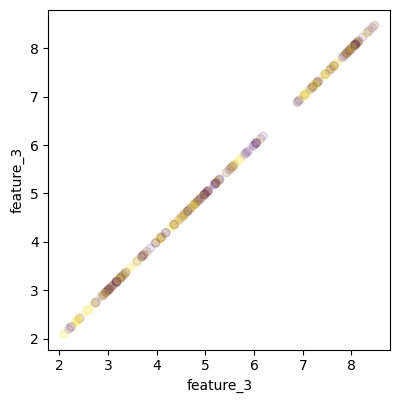

id est: 5
UMAP-PCA, average


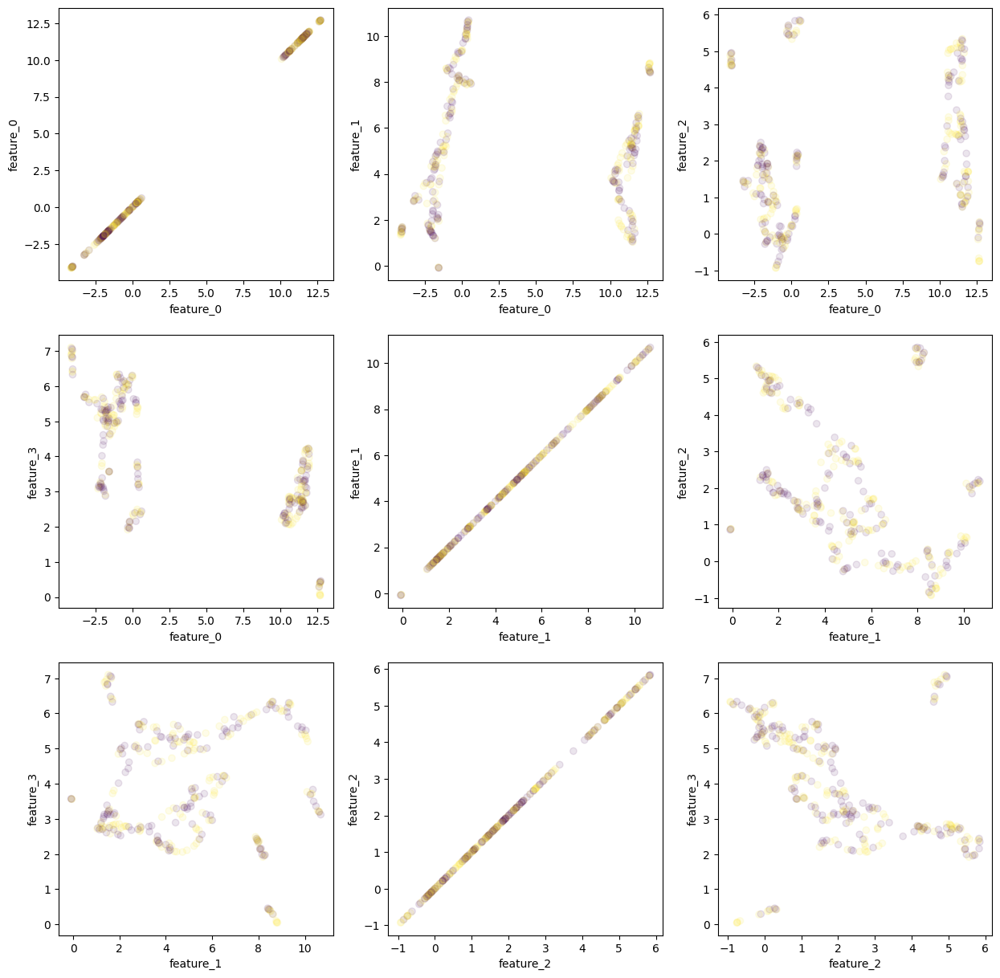

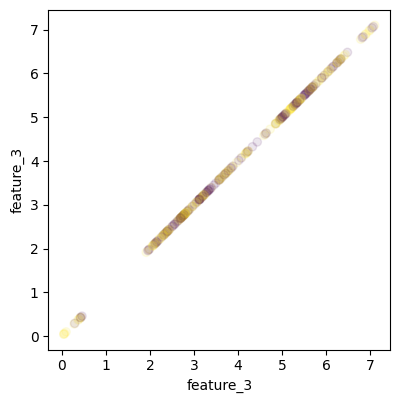

id est: 6
UMAP-PCA, average


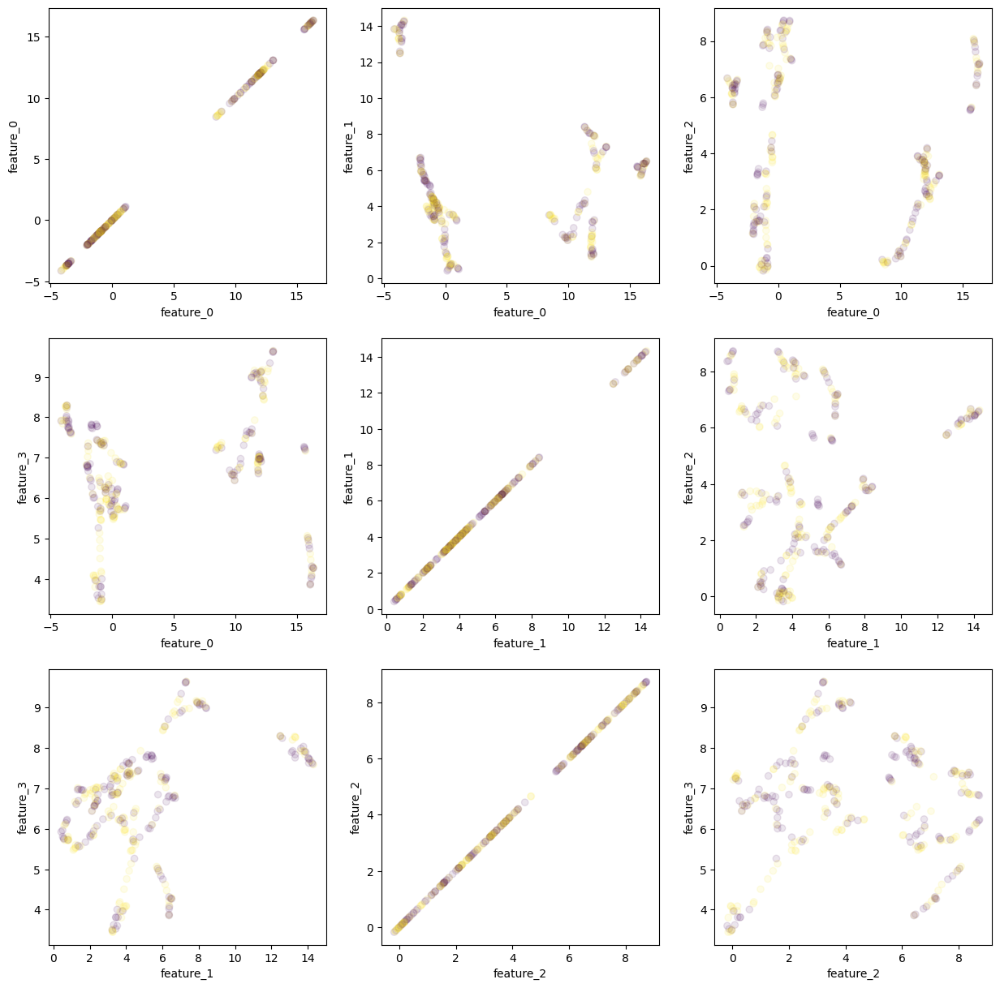

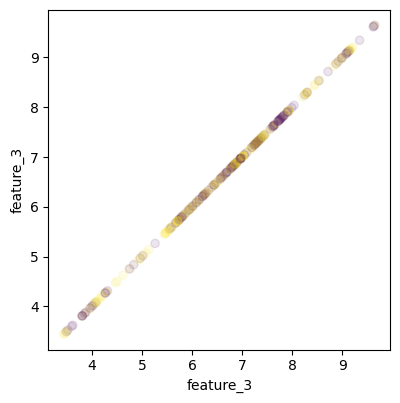

id est: 7
UMAP-PCA, average


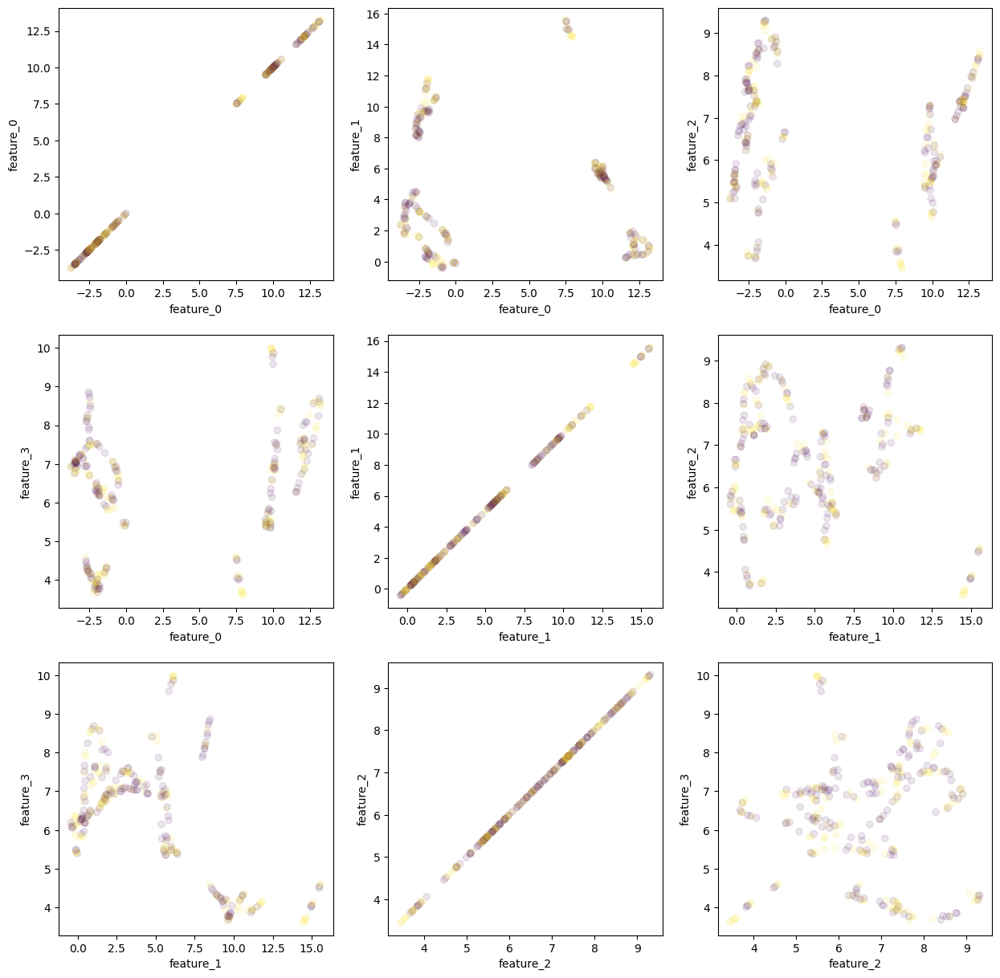

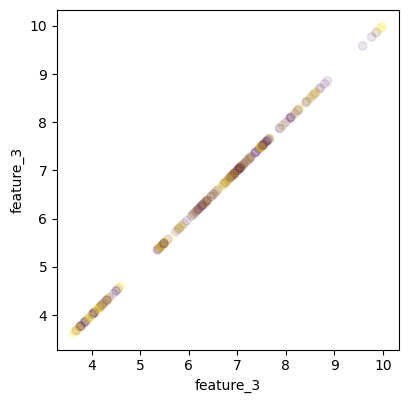

id est: 8
UMAP-PCA, average


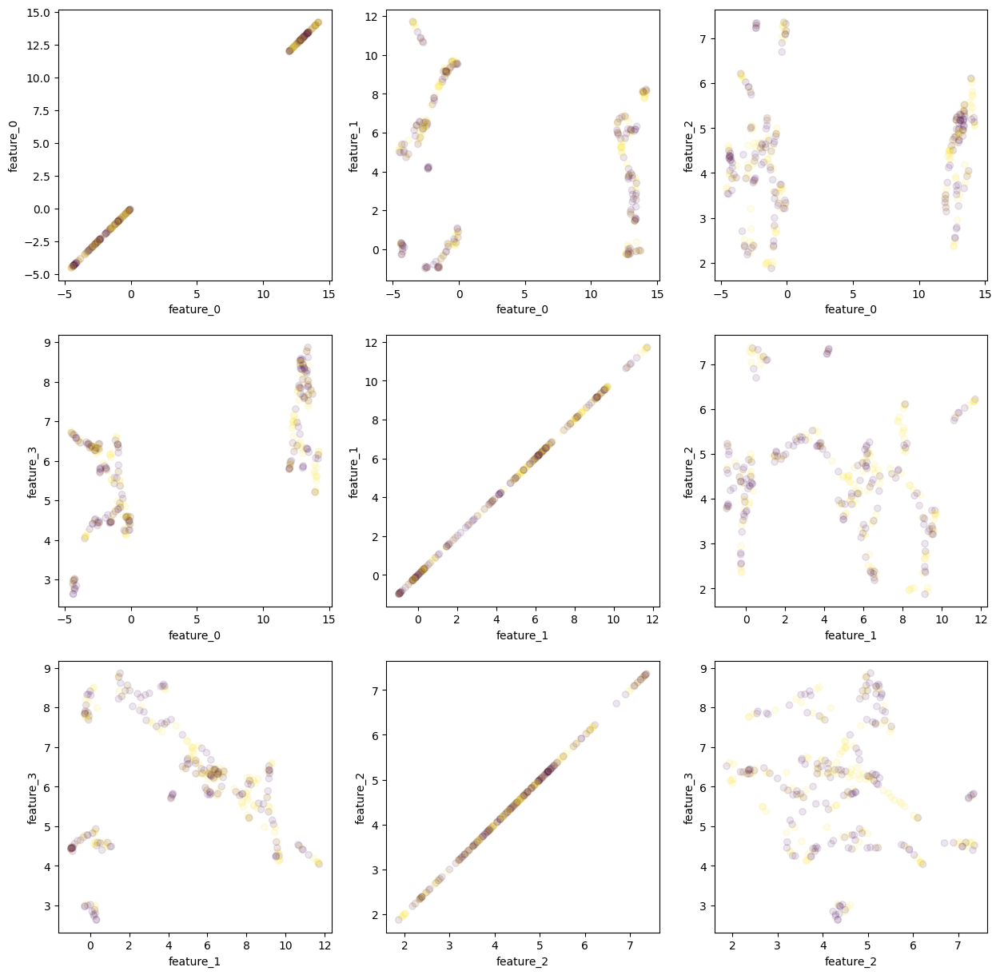

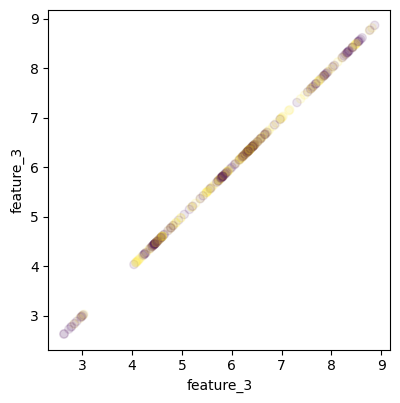

id est: 9
UMAP-PCA, average


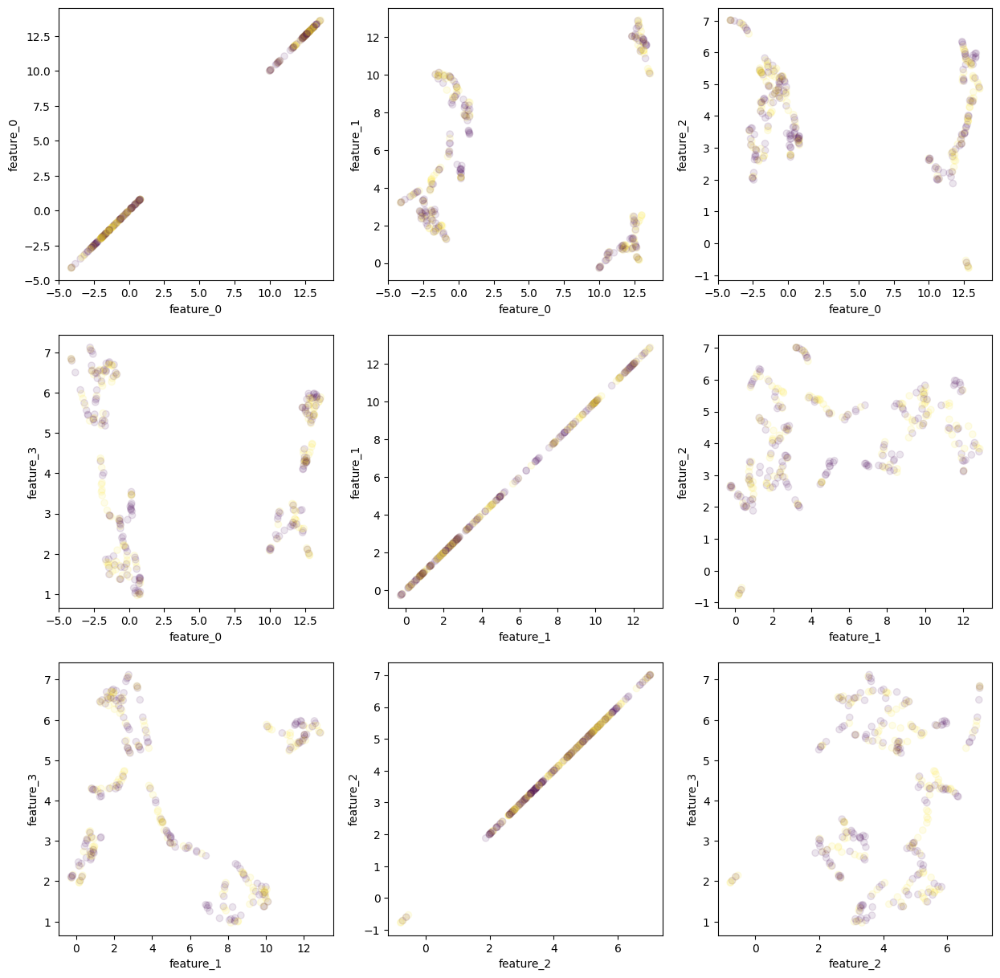

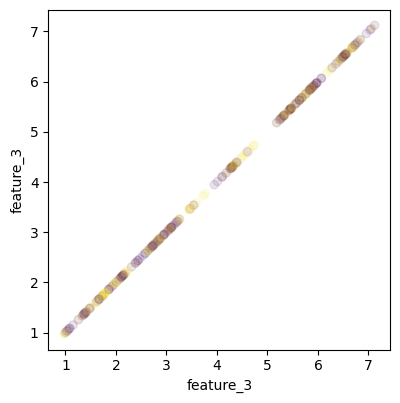

id est: 10
UMAP-PCA, average


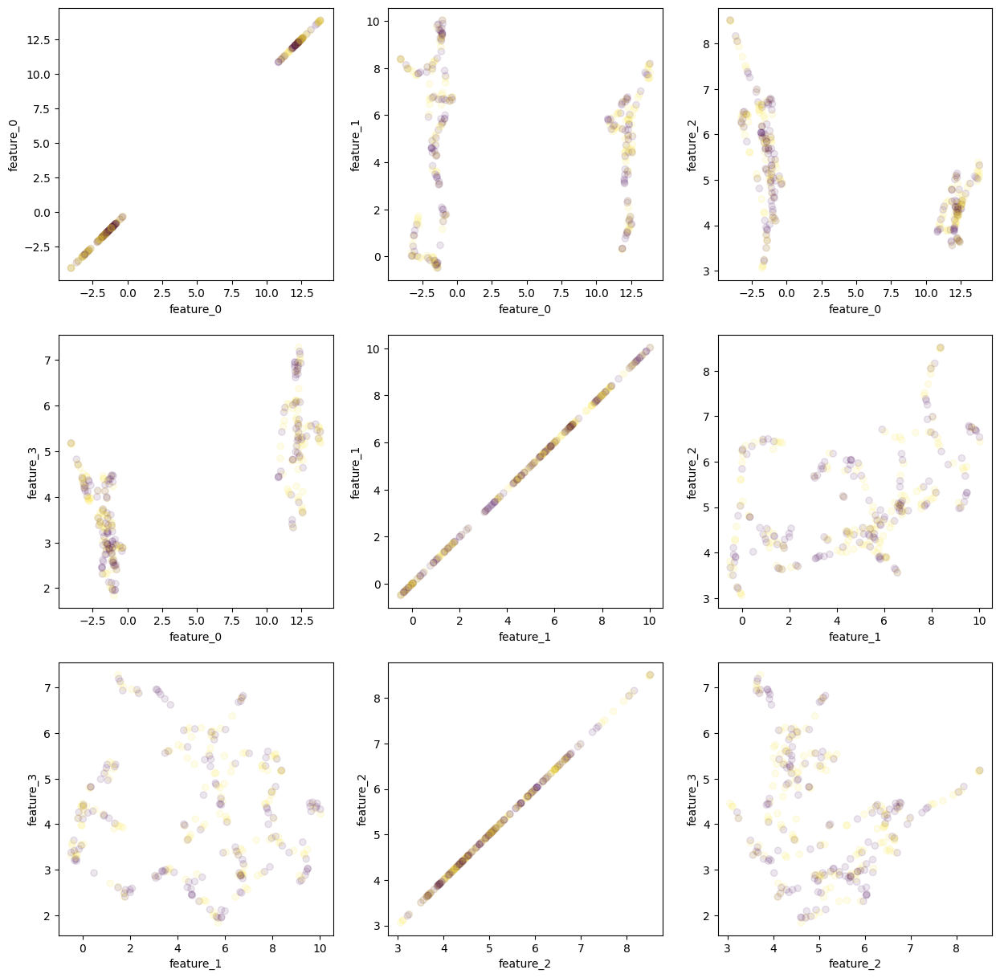

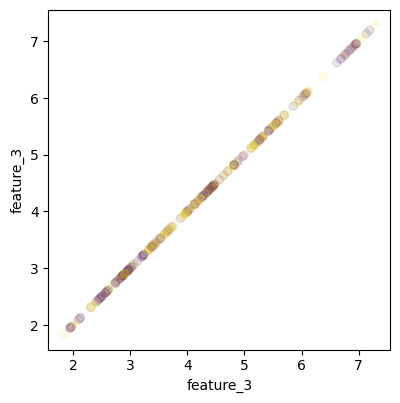

id est: 11
UMAP-PCA, average


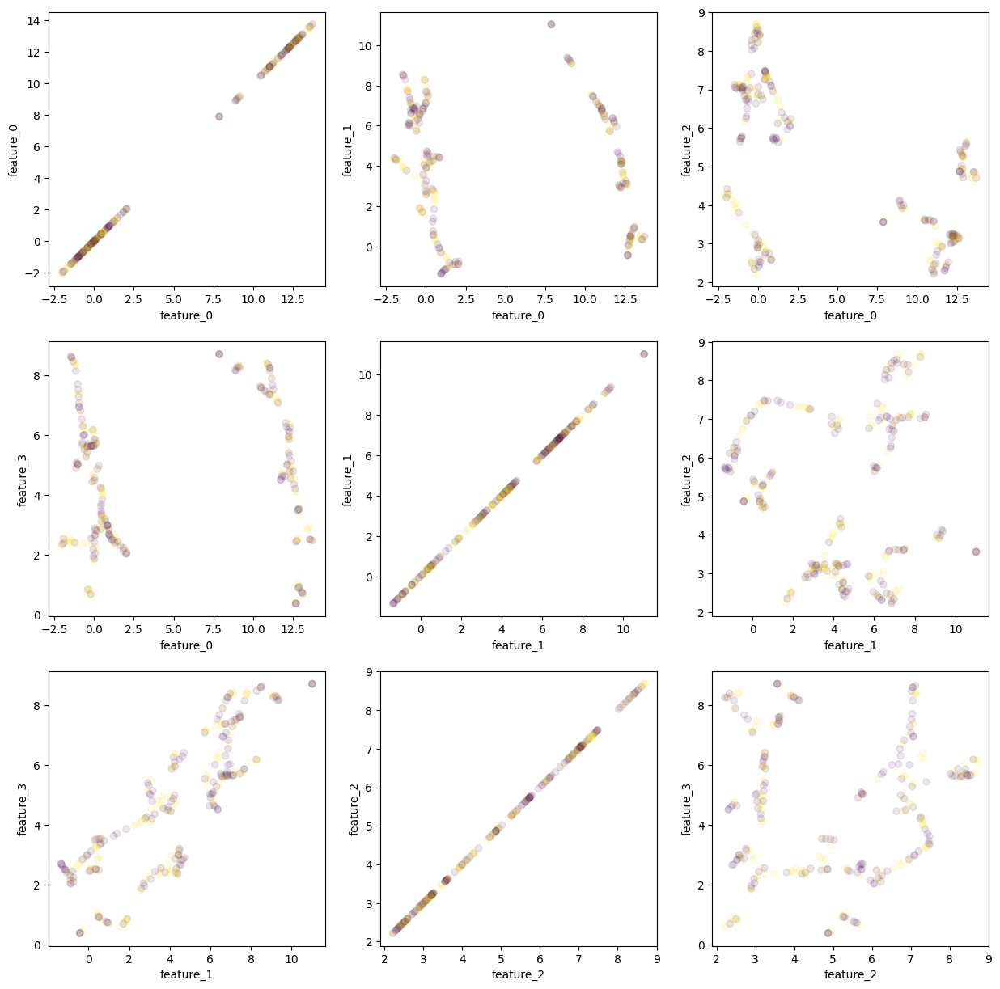

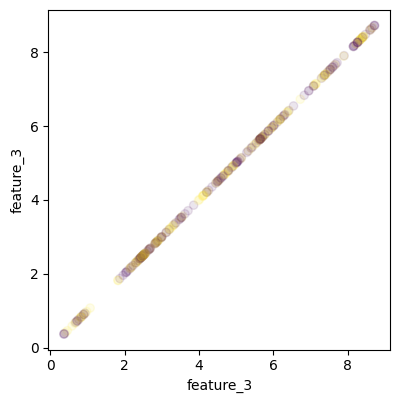

In [217]:
n_ = 300
w = 7
n = n_ * w

ages_2 = ages_[0:n] / 100   # scaling
sexs_2 = sexs_[0:n]

for i in range(12):
    X_2 = test_data[i][0:n]
    y_2 = y_test[i][0:n]

    plt.rcParams['figure.figsize'] = [15, 15]

    print("id est:", i)
    umaper_pca_age_sex_patient_average(models[k], X_2, y_2, ages_2, sexs_2, n_components=4, alpha=0.1)